In [2]:
# retina
%config InlineBackend.figure_format = 'retina'

In [1]:
%load_ext autoreload
%autoreload 2

In [7]:
import os
from pathlib import Path
import pickle
import numpy as np
from matplotlib import pyplot as plt
from astropy.io import fits
from astropy.table import Table
import eazy

from matplotlib import rcParams
plt.rcParams["font.size"] = 20
plt.rcParams["axes.labelsize"] = 25

WD = Path('/data1/hbahk/spherex-photoz/spherex-challenge/challenge')
OUTDIR = WD / 'output'
FIGDIR = OUTDIR / 'figures'
os.chdir(WD)

if FIGDIR.exists() is False:
    FIGDIR.mkdir()

from utils import plot_comp_hexbin

SCHEME = ' (102ch only)'

In [144]:
cat = Table.read(WD/'data/L3_COSMOS2020_Richard_2023DEC4_SPHEREx_fiducial102_more.fits')
cat_reduced = cat['source_id', 'x', 'y', 'HSC_i_MAG', 'z_true', 'FLAG_ML']
cat_reduced.write(WD/'data/fiducial102_reduced.fits', overwrite=True)

In [12]:
# make the master output table
base = Table.read(WD/'data/fiducial102_reduced.fits')

base['z_true'] = base['z_true'][:,0]
base['HSC_i_MAG'] = base['HSC_i_MAG'][:,0]

base[:5]

source_id,x,y,HSC_i_MAG,z_true,FLAG_ML
int64,float64,float64,float64,float64,float64
180642,0.0,0.0,23.561245805944896,0.7599,0.0
180650,0.0,0.0,22.238483110379896,0.7945,0.0
180651,0.0,0.0,24.799673329369853,0.8346,0.0
180654,0.0,0.0,24.236406897361483,1.3229,1.0
180657,0.0,0.0,24.744050892069353,2.5462,1.0


In [13]:
output1 = Table.read(OUTDIR/'output16.fits')
output1[:5]

id,nusefilt,z_ml,z_ml_chi2,z_ml_risk,lc_min,lc_max,z_phot,z_phot_chi2,z_phot_risk,z_min_risk,min_risk,z_raw_chi2,raw_chi2,z025,z160,z500,z840,z975,restU,restU_err,restB,restB_err,restV,restV_err,restJ,restJ_err,dL,mass,sfr,Lv,LIR,energy_abs,MLv,Av,mass_p,sfr_p,Lv_p,LIR_p,energy_abs_p,Av_p,ssfr_p,rest270,rest270_err,rest274,rest274_err,rest120,rest120_err,rest121,rest121_err,rest156,rest156_err,rest157,rest157_err,rest158,rest158_err,rest159,rest159_err,rest160,rest160_err,rest161,rest161_err,rest162,rest162_err,rest163,rest163_err,DISTMOD,ABSM_271,ABSM_272,ABSM_274
,,,,,,,,,,,,,,,,,,,,,,,,,,,Mpc,solMass,solMass / yr,solLum,solLum,solLum,solMass / solLum,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
int64,int64,float32,float32,float32,float64,float64,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float64,float64,float64,float64,float64,float64,float64,float64,float64[5],float64[5],float64[5],float64[5],float64[5],float64[5],float64[5],float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float64,float64[5],float64[5],float64[5]
382728,102,0.63785076,81.774765,0.5226718,7394.7,49772.4,0.63785076,81.774765,0.5226718,0.8886997,0.46684173,3.4543834,80.2192,0.2150,0.5136,0.9057,1.3195,2.7409,0.622,0.459,0.921,0.606,1.146,0.724,1.353,0.908,3.8e+03,-9.00e+29,-900000000000000046043660025856.000,-9.00e+29,-9.00e+29,-9.00e+29,-900000000000000046043660025856.00,-900000000000000046043660025856.00,-9.00e+29 .. -9.00e+29,-900000000000000046043660025856.000 .. -900000000000000046043660025856.000,-9.00e+29 .. -9.00e+29,-9.00e+29 .. -9.00e+29,-9.00e+29 .. -9.00e+29,-900000000000000046043660025856.00 .. -900000000000000046043660025856.00,-9.00e+29 .. -9.00e+29,0.309,0.261,0.441,0.320,0.317,0.260,0.394,0.320,0.630,0.458,1.230,0.823,1.359,0.814,1.140,0.625,1.280,0.684,1.353,0.888,1.643,1.304,1.264,1.275,42.364681616494586,-- .. -18.383671179482867,-- .. -18.50287474698775,-- .. -18.4950069338774
382733,102,0.9793253,90.711205,0.45345262,7394.7,49772.4,0.9793253,90.711205,0.45345262,0.9934935,0.45294645,0.98156834,90.7153,0.3016,0.6341,0.9965,1.6701,3.1519,2.355,1.146,2.525,1.120,2.211,0.926,1.095,0.572,6.4e+03,-9.00e+29,-900000000000000046043660025856.000,-9.00e+29,-9.00e+29,-9.00e+29,-900000000000000046043660025856.00,-900000000000000046043660025856.00,-9.00e+29 .. -9.00e+29,-900000000000000046043660025856.000 .. -900000000000000046043660025856.000,-9.00e+29 .. -9.00e+29,-9.00e+29 .. -9.00e+29,-9.00e+29 .. -9.00e+29,-900000000000000046043660025856.00 .. -900000000000000046043660025856.00,-9.00e+29 .. -9.00e+29,3.013,1.867,2.211,1.257,2.631,1.683,2.426,1.374,2.362,1.164,2.822,1.186,2.891,1.199,1.682,0.718,1.485,0.656,1.105,0.610,0.861,0.559,0.612,0.415,43.30270239953402,-- .. -21.336374732297692,-- .. -21.172939749997887,-- .. -21.056313010495934
382741,102,0.7277133,95.23928,0.10078765,7394.7,49772.4,0.7277133,95.23928,0.10078765,0.7680701,0.087949395,0.7840546,95.0611,0.5949,0.6860,0.7700,0.8634,0.9155,3.131,1.064,9.718,1.475,19.585,0.890,56.388,1.504,4.5e+03,-9.00e+29,-900000000000000046043660025856.000,-9.00e+29,-9.00e+29,-9.00e+29,-900000000000000046043660025856.00,-900000000000000046043660025856.00,-9.00e+29 .. -9.00e+29,-900000000000000046043660025856.000 .. -900000000000000046043660025856.000,-9.00e+29 .. -9.00e+29,-9.00e+29 .. -9.00e+29,-9.00e+29 .. -9.00e+29,-900000000000000046043660025856.00 .. -900000000000000046043660025856.00,-9.00e+29 .. -9.00e+29,0.362,0.972,0.801,0.957,0.454,0.914,0.627,1.135,3.052,0.993,12.918,1.906,24.969,1.385,34.886,1.534,45.584,1.374,56.332,1.358,70.606,2.112,60.373,2.750,42.65631380597064,-- .. -19.74127474347064,-- .. -19.98165026226947,-- .. -19.90900698224017
382746,102,1.1488159,87.73475,0.49967527,7394.7,49772.4,1.1488159,87.73475,0.49967527,1.0727757,0.49532685,3.94

In [14]:
colnames = ['z_phot', 'z_phot_chi2', 'z160', 'z840', 'id']
for label in colnames:
    base[label] = np.empty(len(base), dtype=float)

for i in range(17):
    start_id = i*10000
    end_id = (i+1)*10000 if i < 16 else len(base)
    
    outtab = Table.read(OUTDIR/f'output{i:02d}.fits')
    for label in colnames:
        base[label][start_id:end_id] = outtab[label]

In [15]:
base.write(OUTDIR/'result.fits', overwrite=True)

In [5]:
base = Table.read(OUTDIR/'result.fits')

Objects : 165426
Outliers: 110351




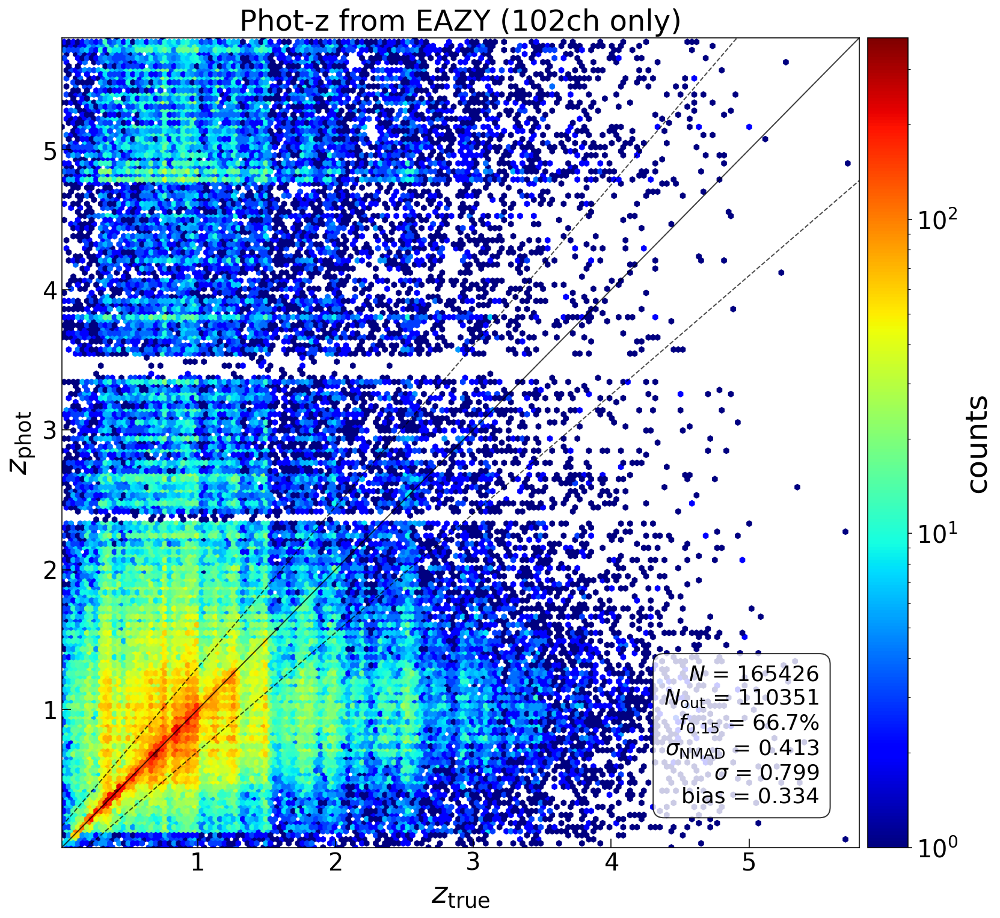

In [27]:
id_out = plot_comp_hexbin(base['z_true'], base['z_phot'], base['z_phot_chi2'],
                          FIGDIR/'all_hexhist.png', base['id'],
                          label_x=r"$z_{\rm true}$", label_y=r"$z_{\rm phot}$",
                          title="Phot-z from EAZY"+SCHEME, xmin=0.015, xmax=5.8, cmap='jet',
                          scatter_plot=False, gridsize=(87*2,50*2), log_scale=False,
                          color_log_scale=True, figsize=(12,11))

Objects : 165426
Outliers: 110351




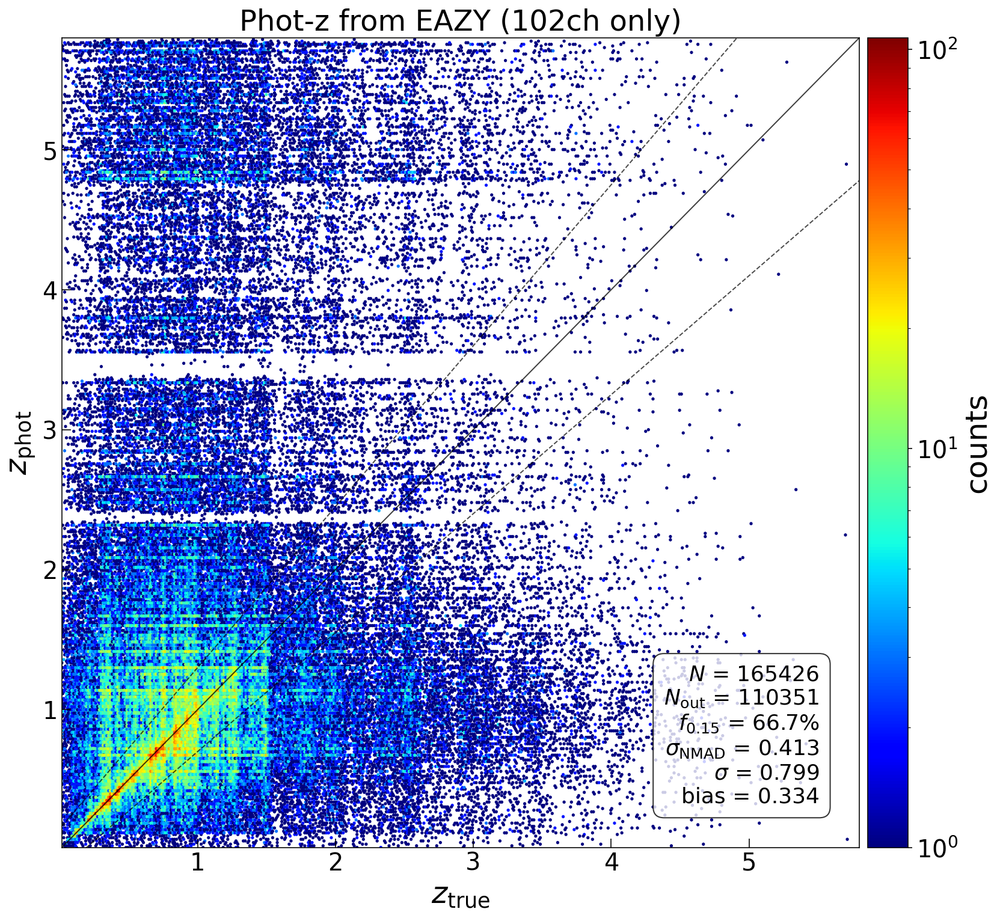

In [28]:
id_out = plot_comp_hexbin(base['z_true'], base['z_phot'], base['z_phot_chi2'],
                          'Fig1-comp_z_eazypy.png', base['id'],
                          label_x=r"$z_{\rm true}$", label_y=r"$z_{\rm phot}$",
                          title="Phot-z from EAZY"+SCHEME, xmin=0.015, xmax=5.8, cmap='jet',
                          scatter_plot=False, gridsize=(87*5,50*5), log_scale=False,
                          color_log_scale=True, figsize=(12, 11))

Objects : 368
Outliers: 0




/data1/hbahk/spherex-photoz/spherex-challenge/challenge/utils.py:311: RuntimeWarning: divide by zero encountered in divide
  sigz = (np.max([z_840 - z_phot, z_phot - z_160], axis=0) / (1 + z_phot))


Objects : 368
Outliers: 0




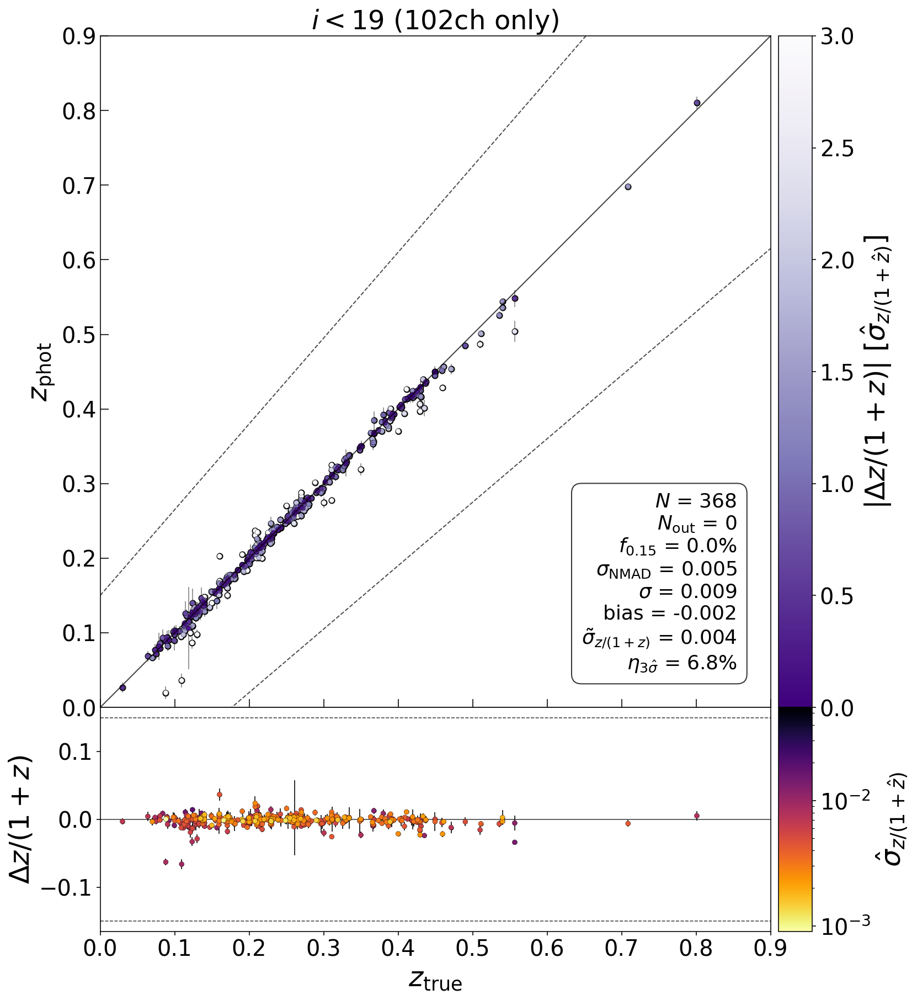

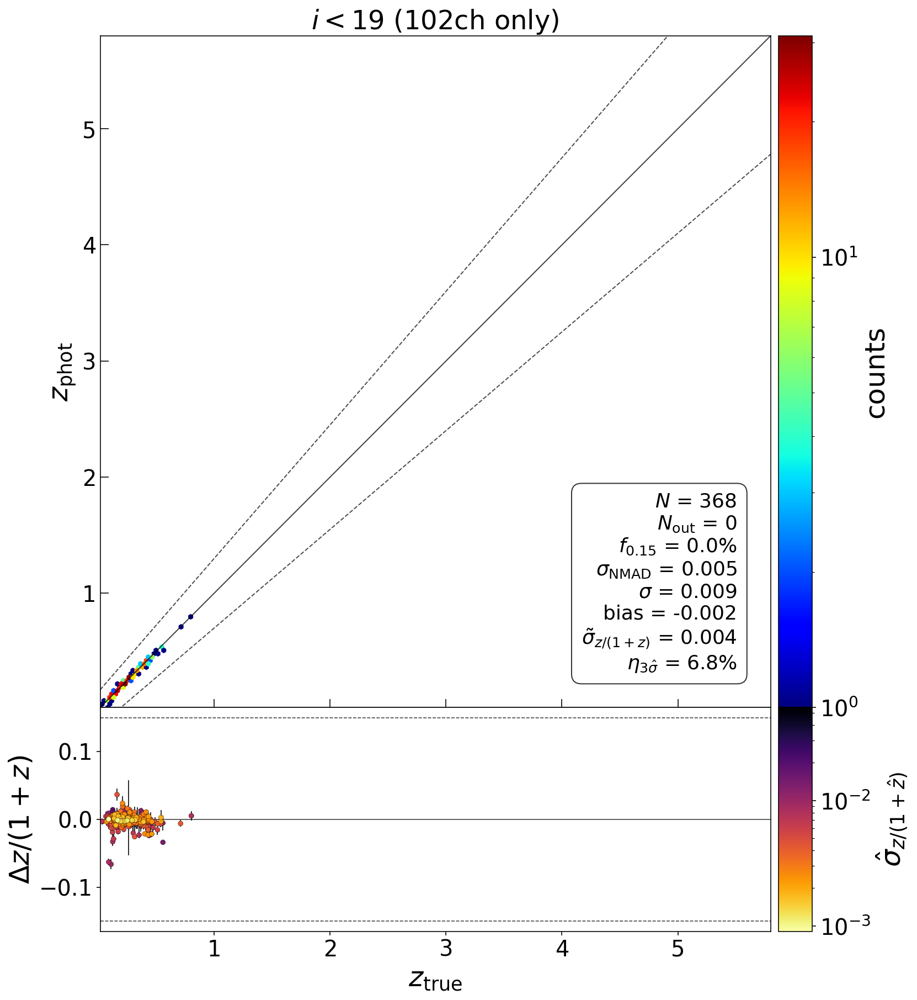

In [29]:
imask = base['HSC_i_MAG'] < 19

# id_out = plot_comp_hexbin(base['z_true'][imask], base['z_phot'][imask],
#                           base['z_phot_chi2'][imask],
#                           'Fig1-comp_z_eazypy.png', base['id'][imask],
#                           label_x=r"$z_{\rm true}$", label_y=r"$z_{\rm phot}$",
#                           title="$i<19$", xmin=0.015, xmax=5.8, cmap='jet',
#                           scatter_plot=False, gridsize=(87,50), log_scale=False)
id_out = plot_comp_hexbin(base['z_true'][imask], base['z_phot'][imask],
                          base['z_phot_chi2'][imask],
                          FIGDIR/'i19_scatter.png', base['id'][imask],
                          z_160=base['z160'][imask], z_840=base['z840'][imask],
                          label_x=r"$z_{\rm true}$", label_y=r"$z_{\rm phot}$",
                          title="$i<19$"+SCHEME, xmin=0, xmax=0.9, cmap='jet',
                          scatter_plot=True, gridsize=(87,50), log_scale=False,
                          residual_plot=True, no_hexbin=True)
id_out = plot_comp_hexbin(base['z_true'][imask], base['z_phot'][imask],
                          base['z_phot_chi2'][imask],
                          FIGDIR/'i19_hexhist.png', base['id'][imask],
                          z_160=base['z160'][imask], z_840=base['z840'][imask],
                          label_x=r"$z_{\rm true}$", label_y=r"$z_{\rm phot}$",
                          title="$i<19$"+SCHEME, xmin=0.015, xmax=5.8, cmap='jet',
                          scatter_plot=False, gridsize=(87*2,50*2), log_scale=False,
                          residual_plot=True)

Objects : 1267
Outliers: 0


Objects : 1267
Outliers: 0




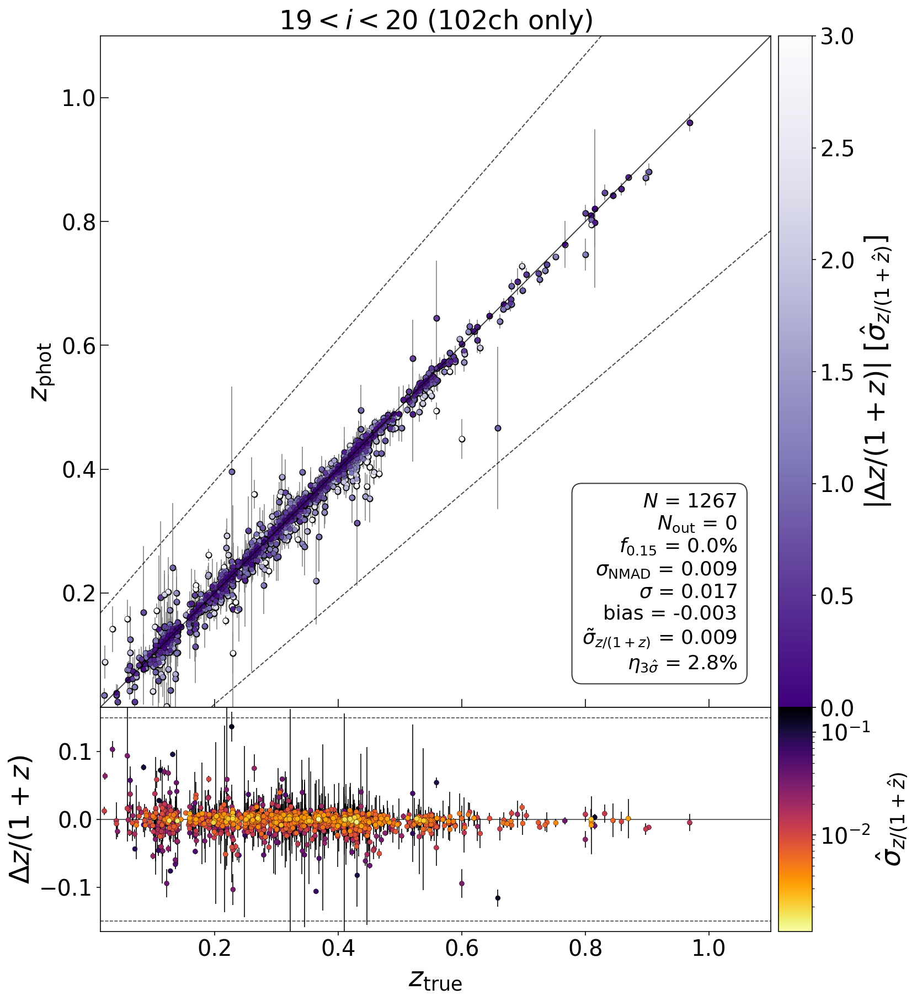

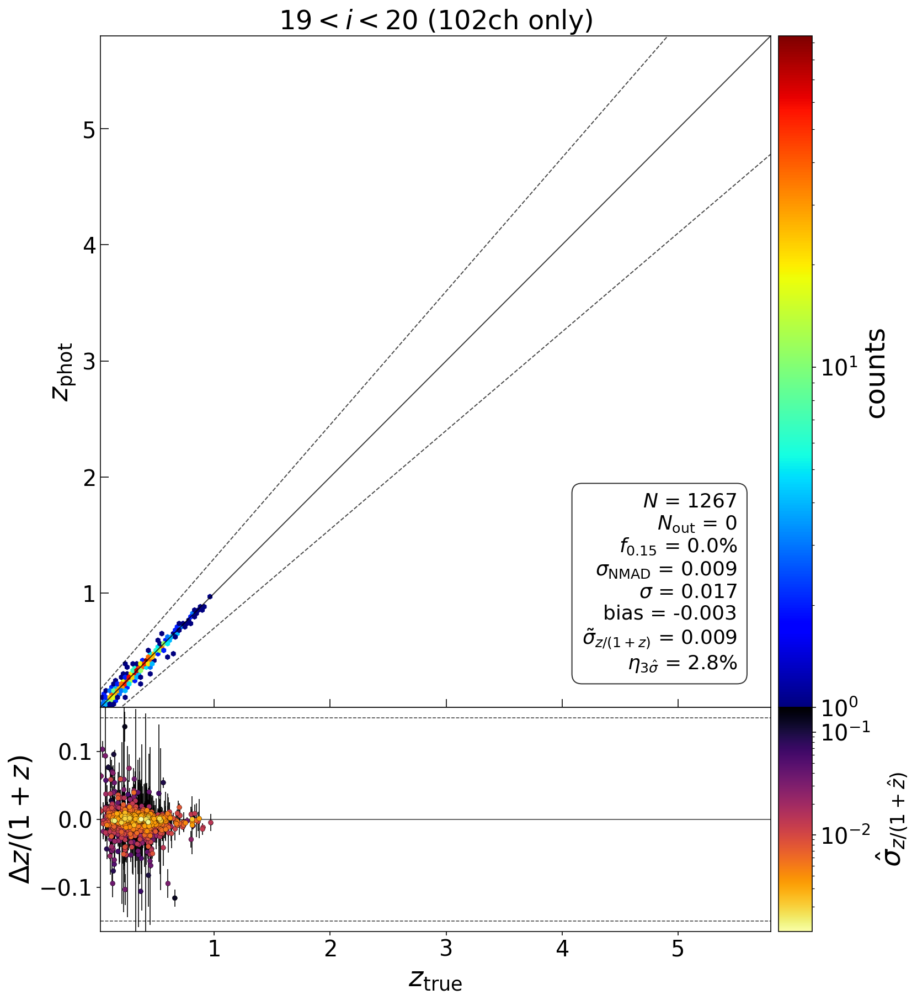

In [30]:
imask = (base['HSC_i_MAG'] > 19) & (base['HSC_i_MAG'] < 20)

id_out = plot_comp_hexbin(base['z_true'][imask], base['z_phot'][imask],
                          base['z_phot_chi2'][imask],
                          FIGDIR/'i20_scatter.png', base['id'][imask],
                          z_160=base['z160'][imask], z_840=base['z840'][imask],
                          label_x=r"$z_{\rm true}$", label_y=r"$z_{\rm phot}$",
                          title="$19<i<20$"+SCHEME, xmin=0.015, xmax=1.1, cmap='jet',
                          scatter_plot=True, gridsize=(87,50), log_scale=False,
                          residual_plot=True, no_hexbin=True)
id_out = plot_comp_hexbin(base['z_true'][imask], base['z_phot'][imask],
                          base['z_phot_chi2'][imask],
                          FIGDIR/'i20_hexhist.png', base['id'][imask],
                          z_160=base['z160'][imask], z_840=base['z840'][imask],
                          label_x=r"$z_{\rm true}$", label_y=r"$z_{\rm phot}$",
                          title="$19<i<20$"+SCHEME, xmin=0.015, xmax=5.8, cmap='jet',
                          scatter_plot=False, gridsize=(87*2,50*2), log_scale=False,
                          residual_plot=True)

Objects : 3564
Outliers: 105


Objects : 3564
Outliers: 105




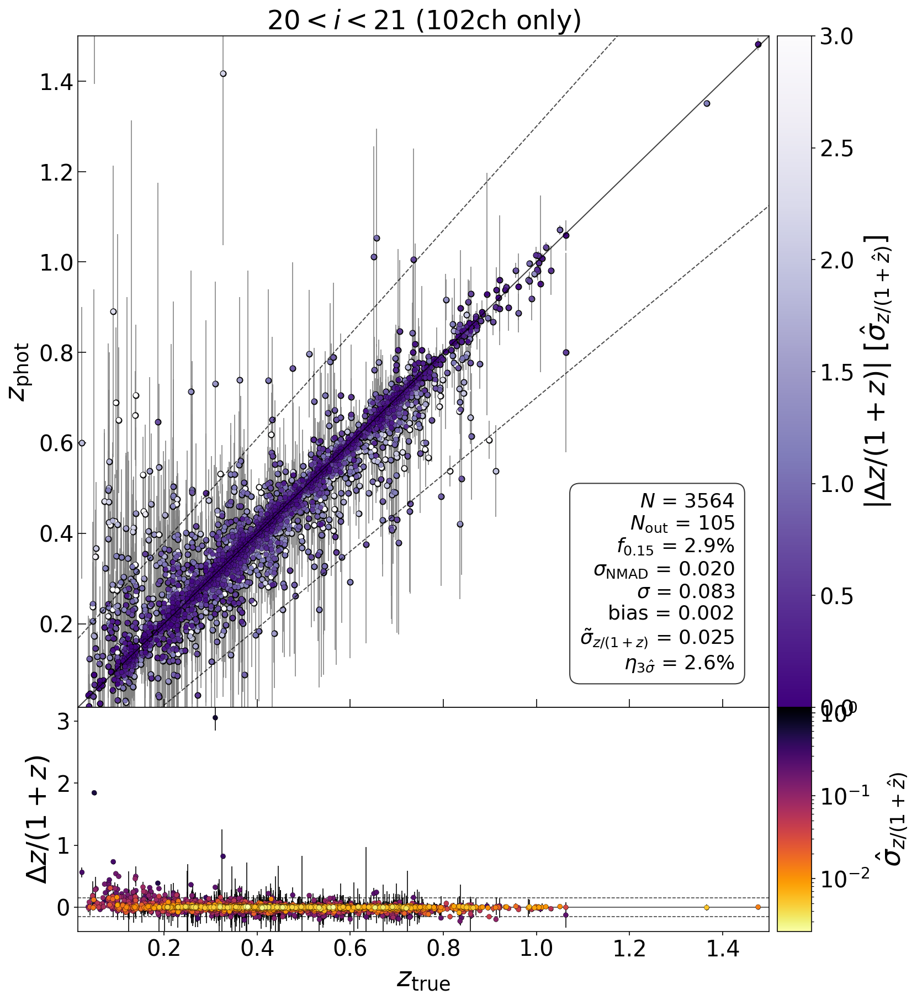

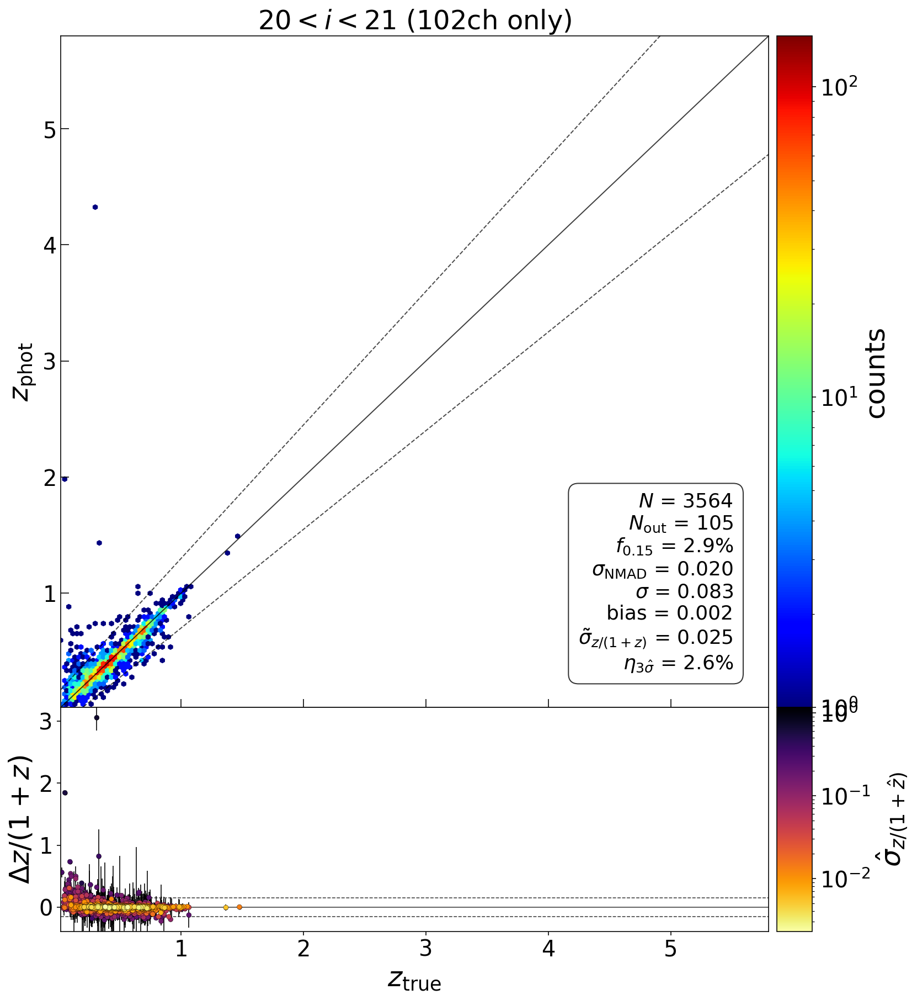

In [31]:
imask = (base['HSC_i_MAG'] > 20) & (base['HSC_i_MAG'] < 21)

# id_out = plot_comp_hexbin(base['z_true'][imask], base['z_phot'][imask],
#                           base['z_phot_chi2'][imask],
#                           'Fig1-comp_z_eazypy.png', base['id'][imask],
#                           label_x=r"$z_{\rm true}$", label_y=r"$z_{\rm phot}$",
#                           title="$20<i<21$", xmin=0.015, xmax=5.8, cmap='jet',
#                           scatter_plot=False, gridsize=(87*5,50*5), log_scale=False,
#                           color_log_scale=True)
id_out = plot_comp_hexbin(base['z_true'][imask], base['z_phot'][imask],
                          base['z_phot_chi2'][imask],
                          FIGDIR/'i21_scatter.png', base['id'][imask],
                          z_160=base['z160'][imask], z_840=base['z840'][imask],
                          label_x=r"$z_{\rm true}$", label_y=r"$z_{\rm phot}$",
                          title="$20<i<21$"+SCHEME, xmin=0.015, xmax=1.5, cmap='jet',
                          scatter_plot=True, gridsize=(87,50), log_scale=False,
                          residual_plot=True, no_hexbin=True)
id_out = plot_comp_hexbin(base['z_true'][imask], base['z_phot'][imask],
                          base['z_phot_chi2'][imask],
                          FIGDIR/'i21_hexhist.png', base['id'][imask],
                          z_160=base['z160'][imask], z_840=base['z840'][imask],
                          label_x=r"$z_{\rm true}$", label_y=r"$z_{\rm phot}$",
                          title="$20<i<21$"+SCHEME, xmin=0.015, xmax=5.8, cmap='jet',
                          scatter_plot=False, gridsize=(87*2,50*2), log_scale=False,
                          residual_plot=True)

Objects : 9323
Outliers: 2089


Objects : 9323
Outliers: 2089




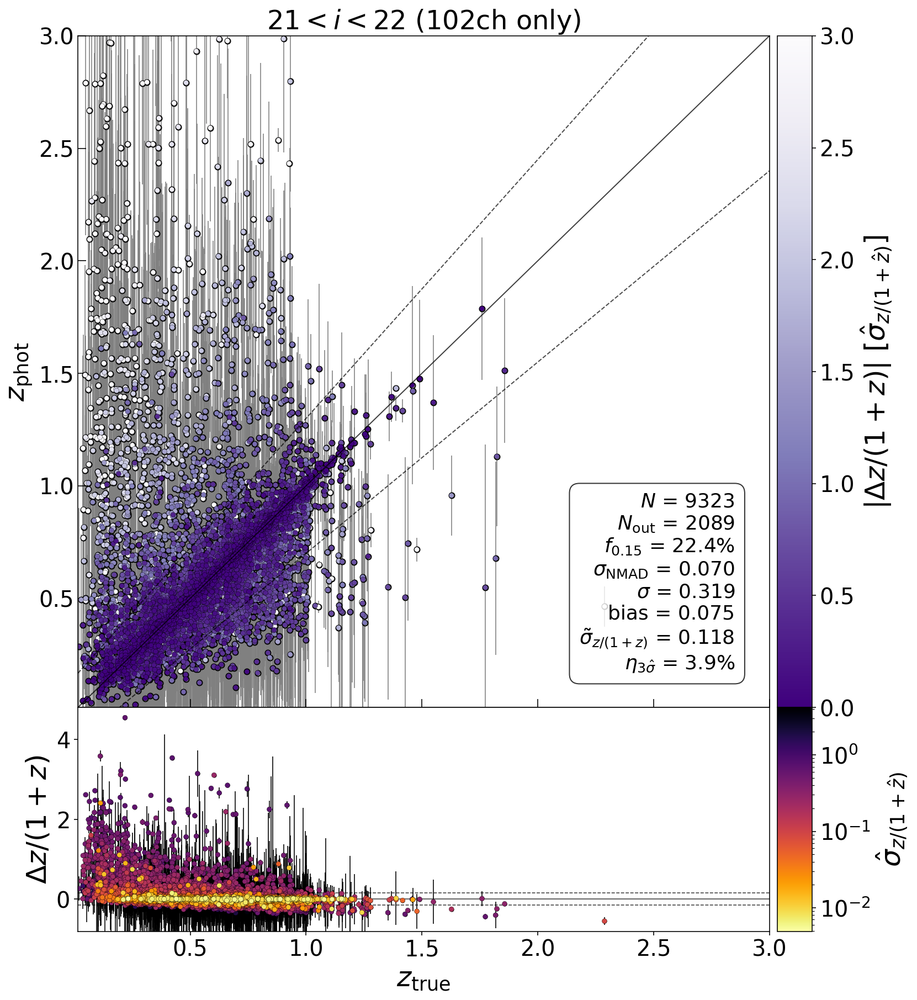

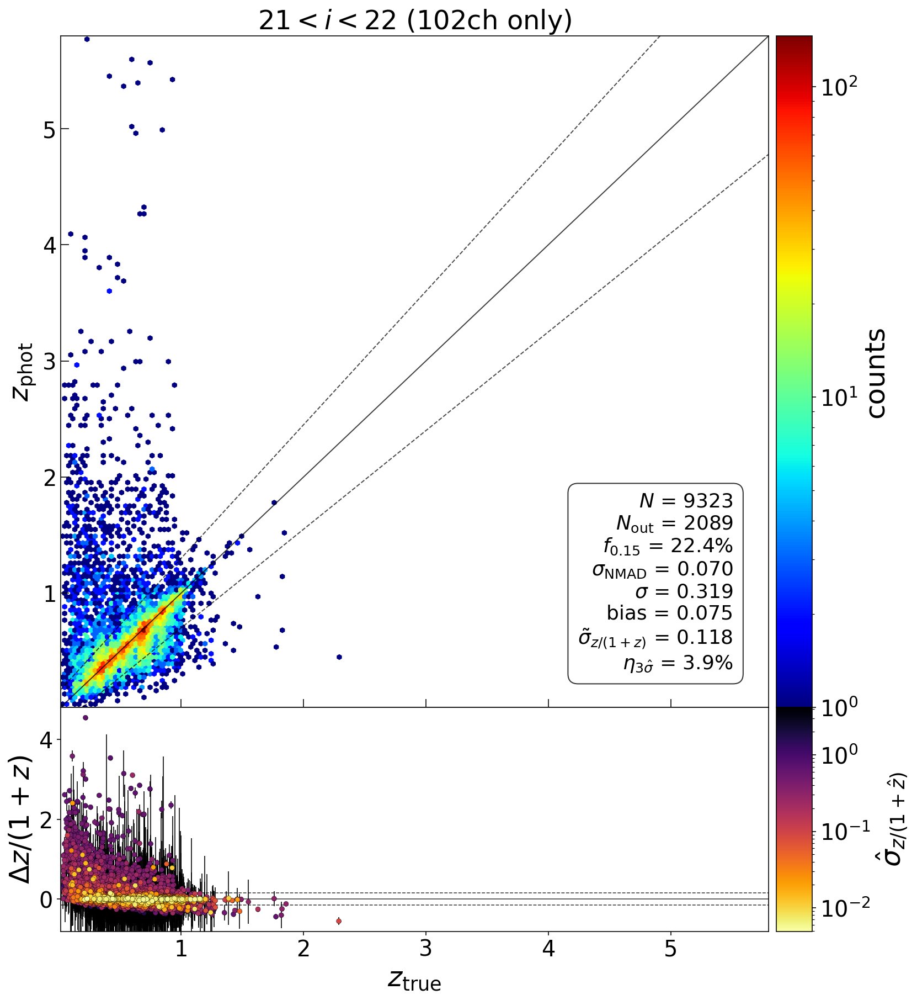

In [32]:
imask = (base['HSC_i_MAG'] > 21) & (base['HSC_i_MAG'] < 22)

# id_out = plot_comp_hexbin(base['z_true'][imask], base['z_phot'][imask],
#                           base['z_phot_chi2'][imask],
#                           'Fig1-comp_z_eazypy.png', base['id'][imask],
#                           label_x=r"$z_{\rm true}$", label_y=r"$z_{\rm phot}$",
#                           title="$21<i<22$", xmin=0.015, xmax=5.8, cmap='jet',
#                           scatter_plot=False, gridsize=(87,50), log_scale=False)
id_out = plot_comp_hexbin(base['z_true'][imask], base['z_phot'][imask],
                          base['z_phot_chi2'][imask],
                          FIGDIR/'i22_scatter.png', base['id'][imask],
                          z_160=base['z160'][imask], z_840=base['z840'][imask],
                          label_x=r"$z_{\rm true}$", label_y=r"$z_{\rm phot}$",
                          title="$21<i<22$"+SCHEME, xmin=0.015, xmax=3, cmap='jet',
                          scatter_plot=True, gridsize=(87,50), log_scale=False,
                          residual_plot=True, no_hexbin=True)
id_out = plot_comp_hexbin(base['z_true'][imask], base['z_phot'][imask],
                          base['z_phot_chi2'][imask],
                          FIGDIR/'i22_hexhist.png', base['id'][imask],
                          z_160=base['z160'][imask], z_840=base['z840'][imask],
                          label_x=r"$z_{\rm true}$", label_y=r"$z_{\rm phot}$",
                          title="$21<i<22$"+SCHEME, xmin=0.015, xmax=5.8, cmap='jet',
                          scatter_plot=False, gridsize=(87*2,50*2), log_scale=False,
                          residual_plot=True)

Objects : 21229
Outliers: 11284




Objects : 21229
Outliers: 11284




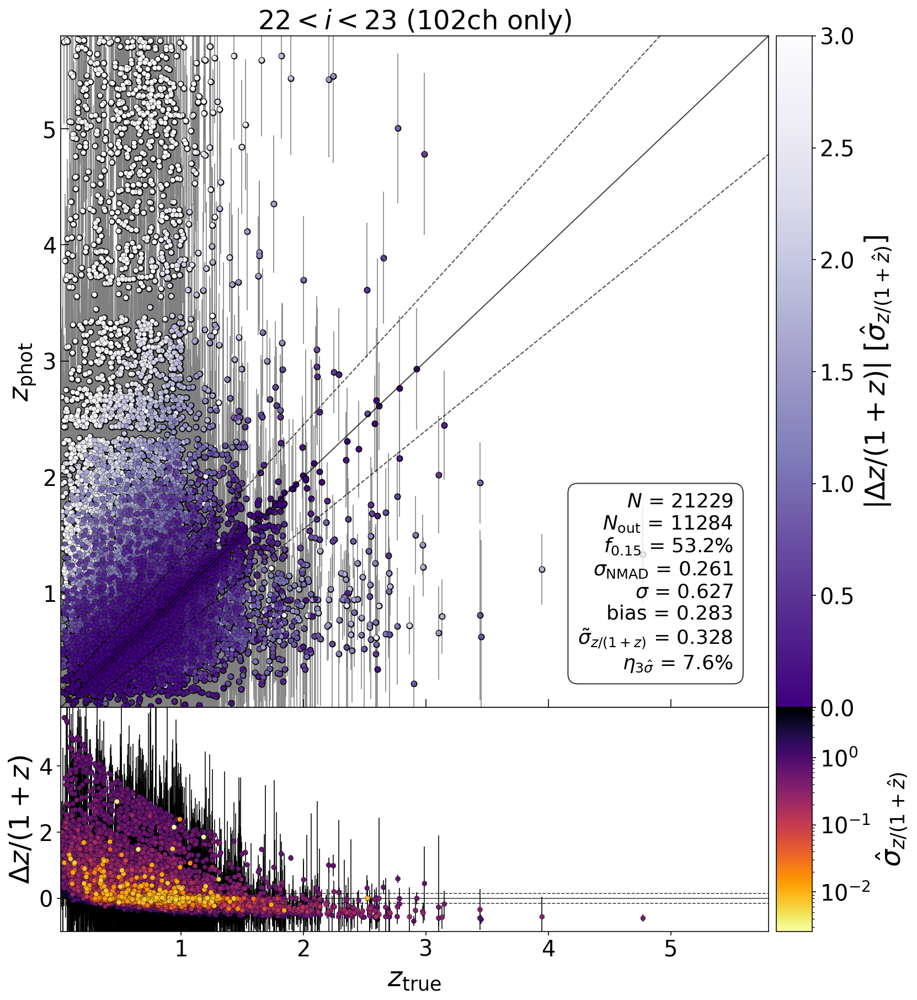

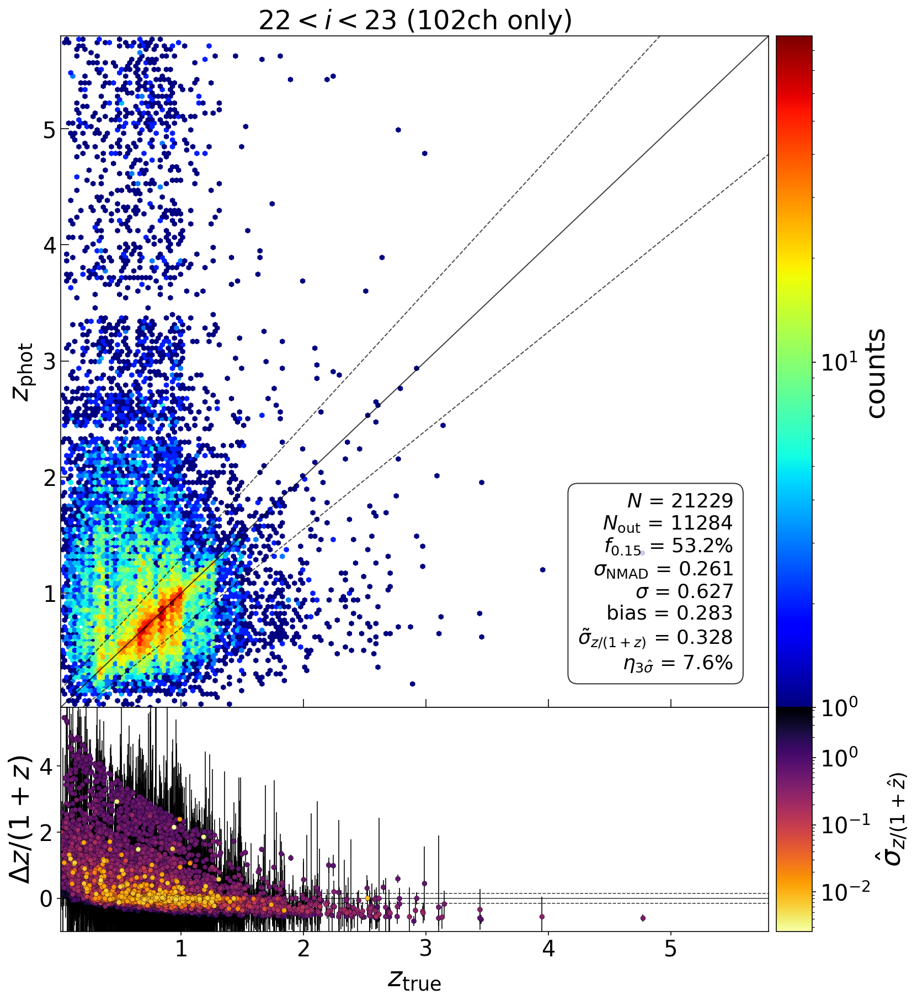

In [33]:
imask = (base['HSC_i_MAG'] > 22) & (base['HSC_i_MAG'] < 23)

# id_out = plot_comp_hexbin(base['z_true'][imask], base['z_phot'][imask],
#                           base['z_phot_chi2'][imask],
#                           'Fig1-comp_z_eazypy.png', base['id'][imask],
#                           label_x=r"$z_{\rm true}$", label_y=r"$z_{\rm phot}$",
#                           title="$22<i<23$", xmin=0.015, xmax=5.8, cmap='jet',
#                           scatter_plot=False, gridsize=(87,50), log_scale=False)
id_out = plot_comp_hexbin(base['z_true'][imask], base['z_phot'][imask],
                          base['z_phot_chi2'][imask],
                          FIGDIR/'i23_scatter.png', base['id'][imask],
                          z_160=base['z160'][imask], z_840=base['z840'][imask],
                          label_x=r"$z_{\rm true}$", label_y=r"$z_{\rm phot}$",
                          title="$22<i<23$"+SCHEME, xmin=0.015, xmax=5.8, cmap='jet',
                          scatter_plot=True, gridsize=(87,50), log_scale=False,
                          residual_plot=True, no_hexbin=True)
id_out = plot_comp_hexbin(base['z_true'][imask], base['z_phot'][imask],
                          base['z_phot_chi2'][imask],
                          FIGDIR/'i23_hexhist.png', base['id'][imask],
                          z_160=base['z160'][imask], z_840=base['z840'][imask],
                          label_x=r"$z_{\rm true}$", label_y=r"$z_{\rm phot}$",
                          title="$22<i<23$"+SCHEME, xmin=0.015, xmax=5.8, cmap='jet',
                          scatter_plot=False, gridsize=(87*2,50*2), log_scale=False,
                          residual_plot=True)

Objects : 129675
Outliers: 96873




/data1/hbahk/spherex-photoz/spherex-challenge/challenge/utils.py:311: RuntimeWarning: divide by zero encountered in divide
  sigz = (np.max([z_840 - z_phot, z_phot - z_160], axis=0) / (1 + z_phot))


Objects : 129675
Outliers: 96873




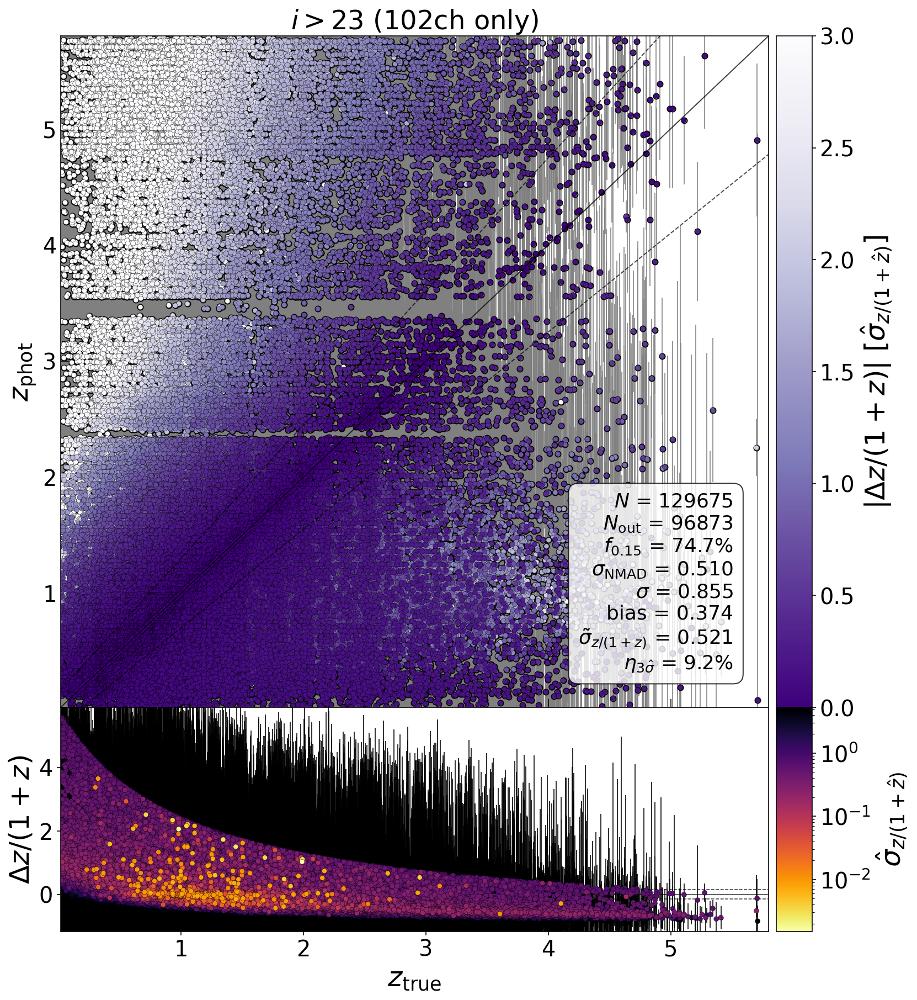

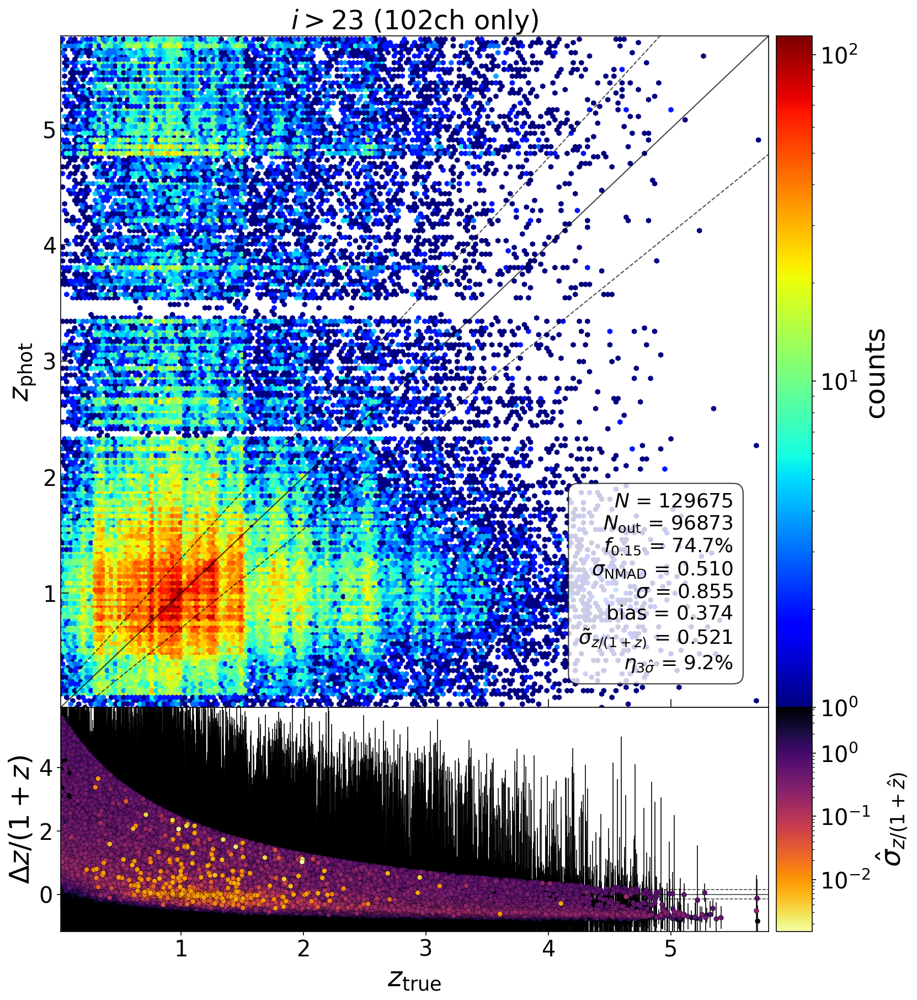

In [46]:
imask = (base['HSC_i_MAG'] > 23)

# id_out = plot_comp_hexbin(base['z_true'][imask], base['z_phot'][imask],
#                           base['z_phot_chi2'][imask],
#                           'Fig1-comp_z_eazypy.png', base['id'][imask],
#                           label_x=r"$z_{\rm true}$", label_y=r"$z_{\rm phot}$",
#                           title="$i>23$", xmin=0.015, xmax=5.8, cmap='jet',
#                           scatter_plot=False, gridsize=(87,50), log_scale=False)
id_out = plot_comp_hexbin(base['z_true'][imask], base['z_phot'][imask],
                          base['z_phot_chi2'][imask],
                          FIGDIR/'i25_scatter.png', base['id'][imask],
                          z_160=base['z160'][imask], z_840=base['z840'][imask],
                          label_x=r"$z_{\rm true}$", label_y=r"$z_{\rm phot}$",
                          title="$i>23$"+SCHEME, xmin=0.015, xmax=5.8, cmap='jet',
                          scatter_plot=True, gridsize=(87,50), log_scale=False,
                          residual_plot=True, no_hexbin=True)
id_out = plot_comp_hexbin(base['z_true'][imask], base['z_phot'][imask],
                          base['z_phot_chi2'][imask],
                          FIGDIR/'i25_hexhist.png', base['id'][imask],
                          z_160=base['z160'][imask], z_840=base['z840'][imask],
                          label_x=r"$z_{\rm true}$", label_y=r"$z_{\rm phot}$",
                          title="$i>23$"+SCHEME, xmin=0.015, xmax=5.8, cmap='jet',
                          scatter_plot=False, gridsize=(87*2,50*2), log_scale=False,
                          residual_plot=True)

/tmp/ipykernel_41676/3782125169.py:2: RuntimeWarning: divide by zero encountered in divide
  np.max([base["z840"] - base["z_phot"], base["z_phot"] - base["z160"]], axis=0)


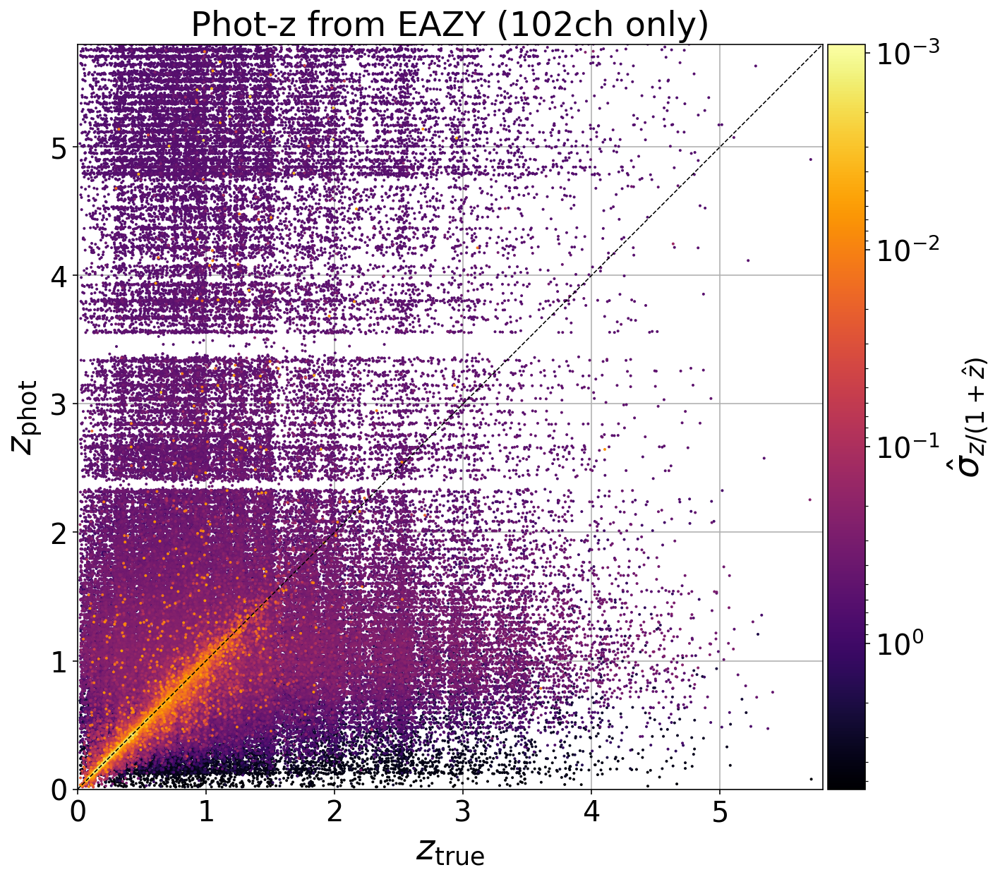

In [35]:
sigz = (
    np.max([base["z840"] - base["z_phot"], base["z_phot"] - base["z160"]], axis=0)
    / (1 + base["z_phot"])
)
idxs = np.argsort(sigz)[::-1]
x, y, s = base['z_true'][idxs], base['z_phot'][idxs], sigz[idxs]
sigzmask = (s > 0)

from matplotlib.colors import LogNorm
from mpl_toolkits.axes_grid1 import make_axes_locatable

fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(111)
sc = ax.scatter(x[sigzmask], y[sigzmask], c=s[sigzmask], s=1, cmap='inferno_r',
                norm=LogNorm())
ax.plot([0, 5.8], [0, 5.8], color='k', lw=0.8, ls='--')
ax.set_xlim(0, 5.8)
ax.set_ylim(0, 5.8)
ax.set_aspect('equal')
ax.set_xlabel(r'$z_{\rm true}$')
ax.set_ylabel(r'$z_{\rm phot}$')
ax.set_axisbelow(True)
ax.grid()

divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)

cbar = plt.colorbar(sc, cax=cax)
cax.invert_yaxis()
cbar.set_label(r'$\hat{\sigma}_{z/(1+\hat{z})}$')

ax.set_title('Phot-z from EAZY'+SCHEME)
fig.savefig(FIGDIR/'sigz.png', dpi=300)

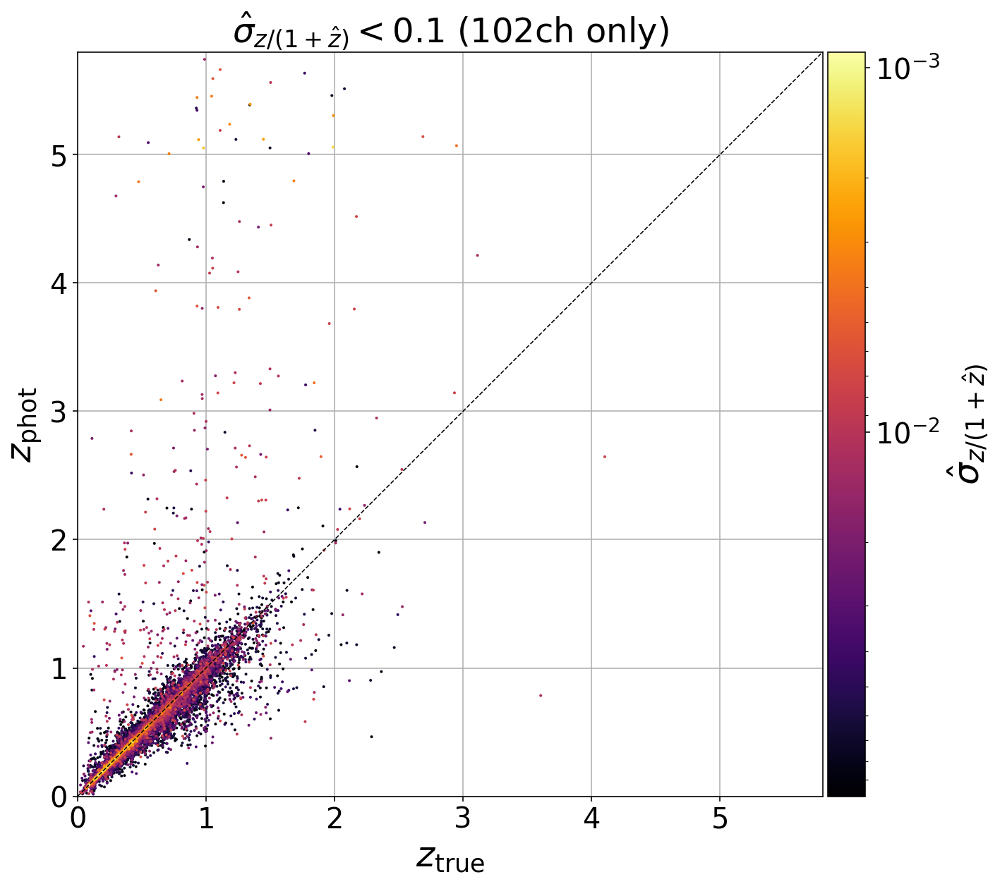

In [36]:
sigzmask = (s < 0.1)

fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(111)
sc = ax.scatter(x[sigzmask], y[sigzmask], c=s[sigzmask], s=1, cmap='inferno_r',
                norm=LogNorm())
ax.plot([0, 5.8], [0, 5.8], color='k', lw=0.8, ls='--')
ax.set_xlim(0, 5.8)
ax.set_ylim(0, 5.8)
ax.set_aspect('equal')
ax.set_xlabel(r'$z_{\rm true}$')
ax.set_ylabel(r'$z_{\rm phot}$')
ax.set_axisbelow(True)
ax.grid()
ax.set_title(r'$\hat{\sigma}_{z/(1+\hat{z})} < 0.1$'+SCHEME)

divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)

cbar = plt.colorbar(sc, cax=cax)
cax.invert_yaxis()
cbar.set_label(r'$\hat{\sigma}_{z/(1+\hat{z})}$')

fig.savefig(FIGDIR/'sigz_lt01.png', dpi=300)

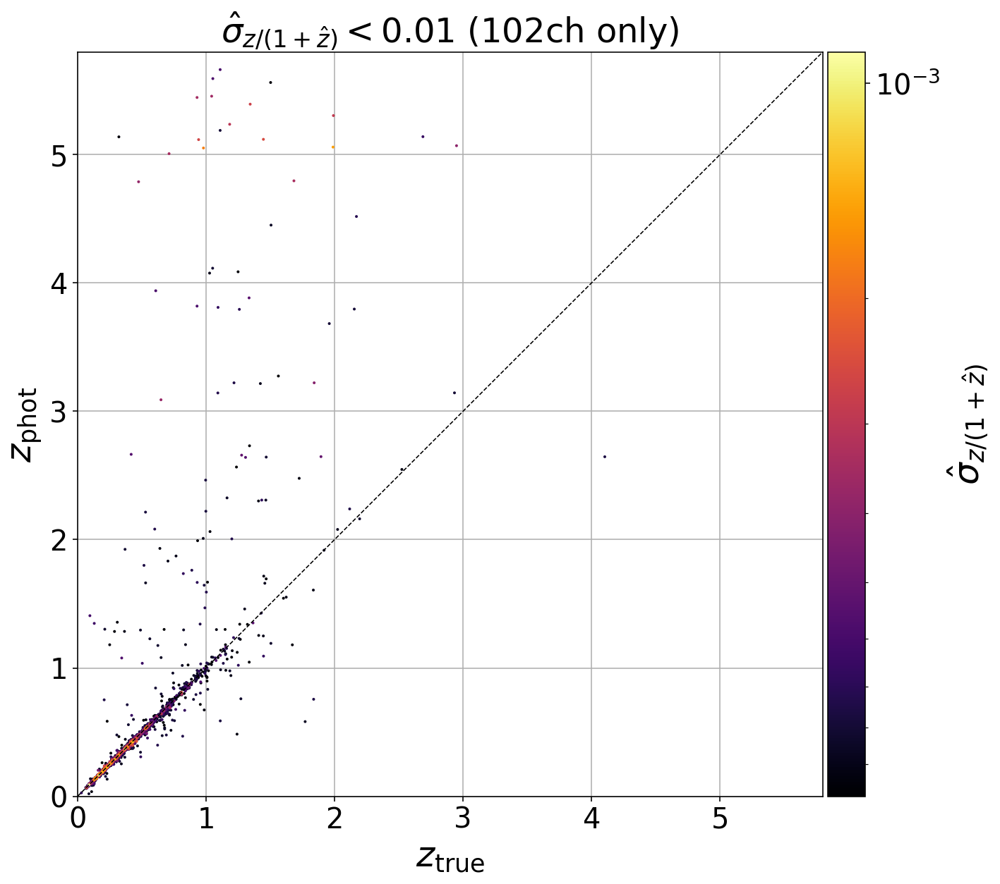

In [37]:
sigzmask = (s < 0.01)

fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(111)
sc = ax.scatter(x[sigzmask], y[sigzmask], c=s[sigzmask], s=1, cmap='inferno_r',
                norm=LogNorm())
ax.plot([0, 5.8], [0, 5.8], color='k', lw=0.8, ls='--')
ax.set_xlim(0, 5.8)
ax.set_ylim(0, 5.8)
ax.set_aspect('equal')
ax.set_xlabel(r'$z_{\rm true}$')
ax.set_ylabel(r'$z_{\rm phot}$')
ax.set_axisbelow(True)
ax.grid()
ax.set_title(r'$\hat{\sigma}_{z/(1+\hat{z})} < 0.01$'+SCHEME)

divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)

cbar = plt.colorbar(sc, cax=cax)
cax.invert_yaxis()
cbar.set_label(r'$\hat{\sigma}_{z/(1+\hat{z})}$')

fig.savefig(FIGDIR/'sigz_lt001.png', dpi=300)

Objects : 12621
Outliers: 592


Objects : 12621
Outliers: 592




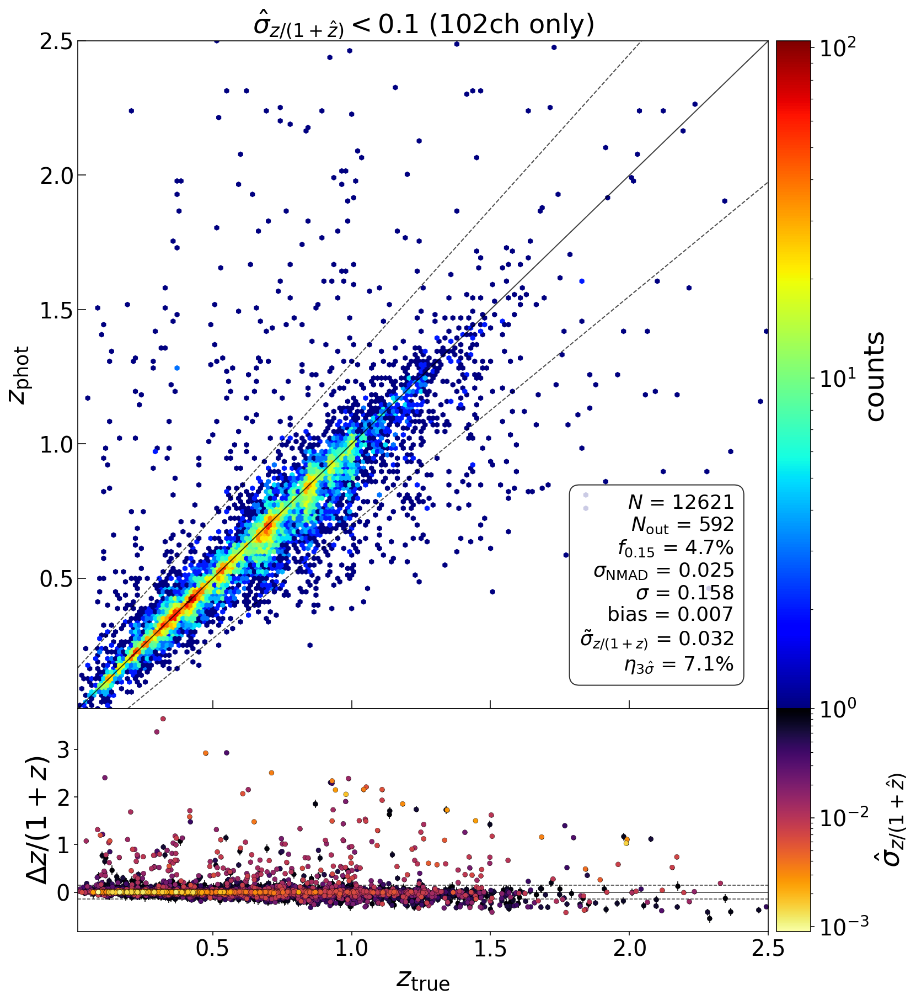

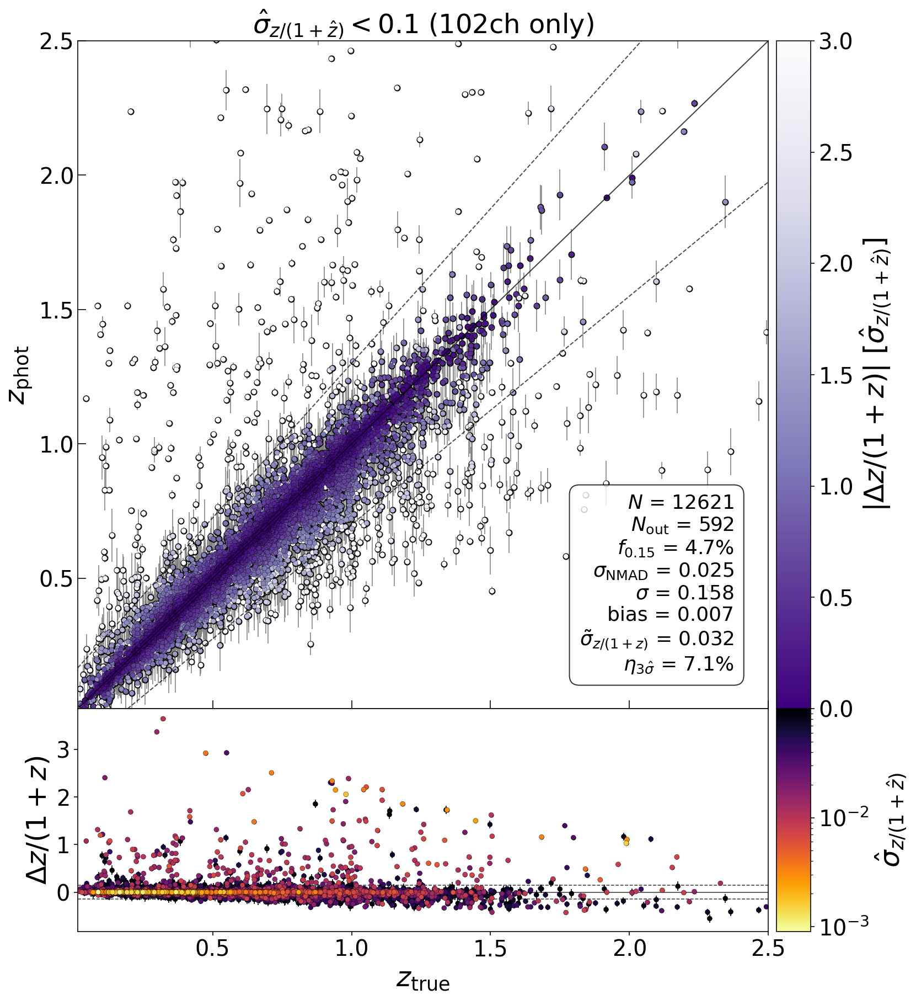

In [38]:
sigzmask = (s < 0.1)

id_out = plot_comp_hexbin(x[sigzmask], y[sigzmask],
                          np.ones_like(x[sigzmask]),
                          FIGDIR/'sigz_hexbin_lt01.png', np.arange(len(x[sigzmask])),
                          z_840=base['z840'][idxs][sigzmask], z_160=base['z160'][idxs][sigzmask],
                          label_x=r"$z_{\rm true}$", label_y=r"$z_{\rm phot}$",
                          title=r'$\hat{\sigma}_{z/(1+\hat{z})} < 0.1$'+SCHEME,
                          xmin=0.015, xmax=2.5, cmap='jet',
                          scatter_plot=False, gridsize=(87*2,50*2), log_scale=False,
                          residual_plot=True)
id_out = plot_comp_hexbin(x[sigzmask], y[sigzmask],
                          np.ones_like(x[sigzmask]),
                          FIGDIR/'sigz_scatter_lt01.png', np.arange(len(x[sigzmask])),
                          z_840=base['z840'][idxs][sigzmask], z_160=base['z160'][idxs][sigzmask],
                          label_x=r"$z_{\rm true}$", label_y=r"$z_{\rm phot}$",
                          title=r'$\hat{\sigma}_{z/(1+\hat{z})} < 0.1$'+SCHEME,
                          xmin=0.015, xmax=2.5, cmap='jet',
                          scatter_plot=True, gridsize=(87*2,50*2), log_scale=False,
                          residual_plot=True, no_hexbin=True)

Objects : 1974
Outliers: 99


Objects : 1974
Outliers: 99




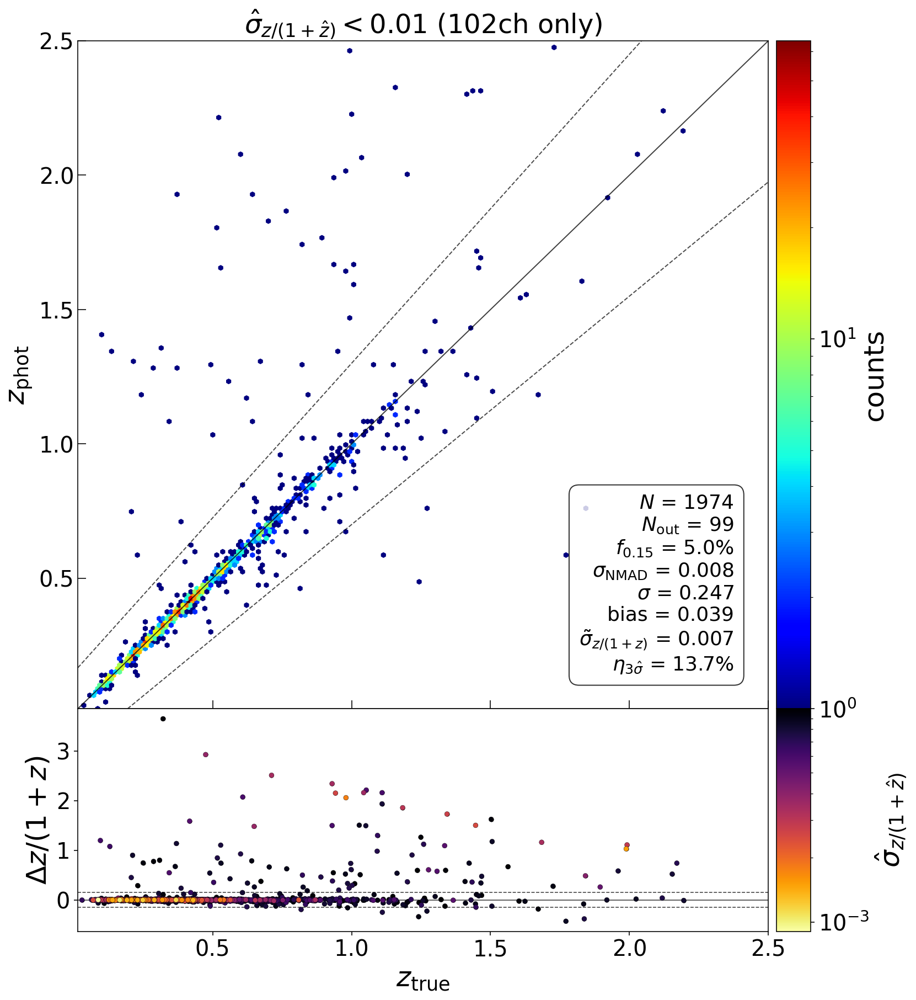

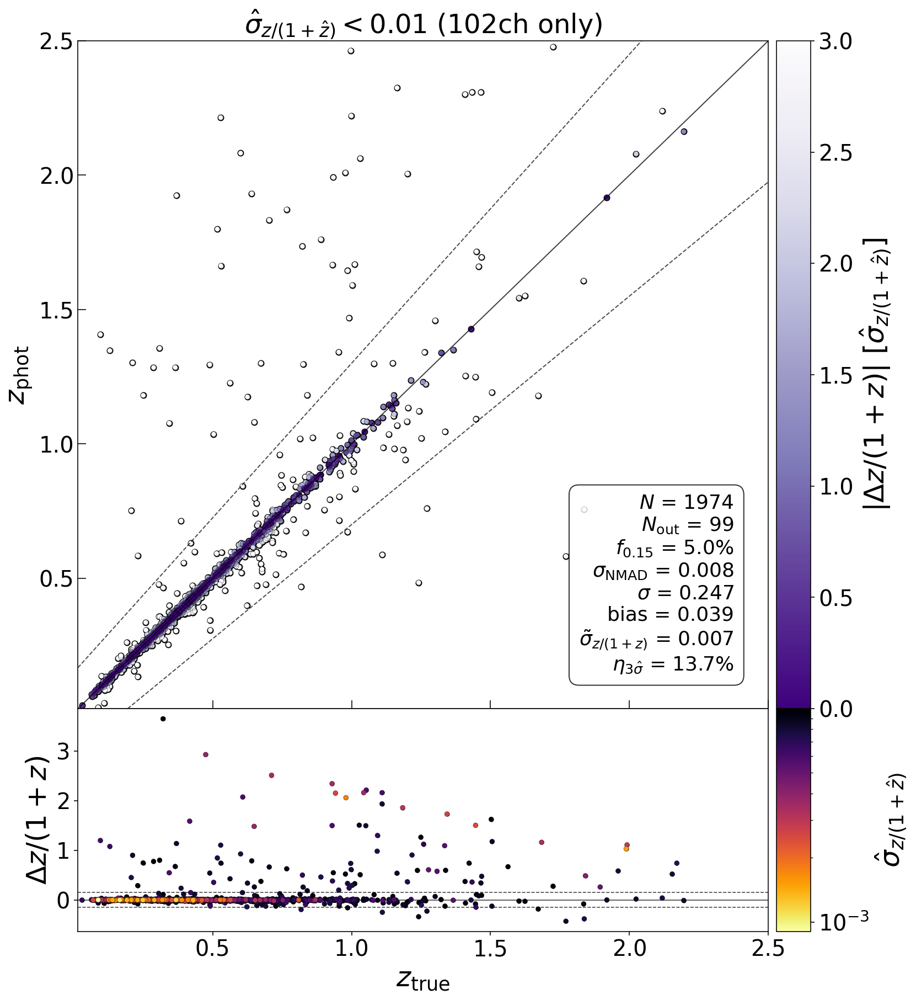

In [39]:
sigzmask = (s < 0.01)

id_out = plot_comp_hexbin(x[sigzmask], y[sigzmask],
                          np.ones_like(x[sigzmask]),
                          FIGDIR/'sigz_hexbin_lt001.png', np.arange(len(x[sigzmask])),
                          z_840=base['z840'][idxs][sigzmask], z_160=base['z160'][idxs][sigzmask],
                          label_x=r"$z_{\rm true}$", label_y=r"$z_{\rm phot}$",
                          title=r'$\hat{\sigma}_{z/(1+\hat{z})} < 0.01$'+SCHEME,
                          xmin=0.015, xmax=2.5, cmap='jet',
                          scatter_plot=False, gridsize=(87*2,50*2), log_scale=False,
                          residual_plot=True, residual_ylim=None)
id_out = plot_comp_hexbin(x[sigzmask], y[sigzmask],
                          np.ones_like(x[sigzmask]),
                          FIGDIR/'sigz_scatter_lt001.png', np.arange(len(x[sigzmask])),
                          z_840=base['z840'][idxs][sigzmask], z_160=base['z160'][idxs][sigzmask],
                          label_x=r"$z_{\rm true}$", label_y=r"$z_{\rm phot}$",
                          title=r'$\hat{\sigma}_{z/(1+\hat{z})} < 0.01$'+SCHEME,
                          xmin=0.015, xmax=2.5, cmap='jet',
                          scatter_plot=True, gridsize=(87*2,50*2), log_scale=False,
                          residual_plot=True, residual_ylim=None, no_hexbin=True)

Objects : 146
Outliers: 6


Objects : 146
Outliers: 6




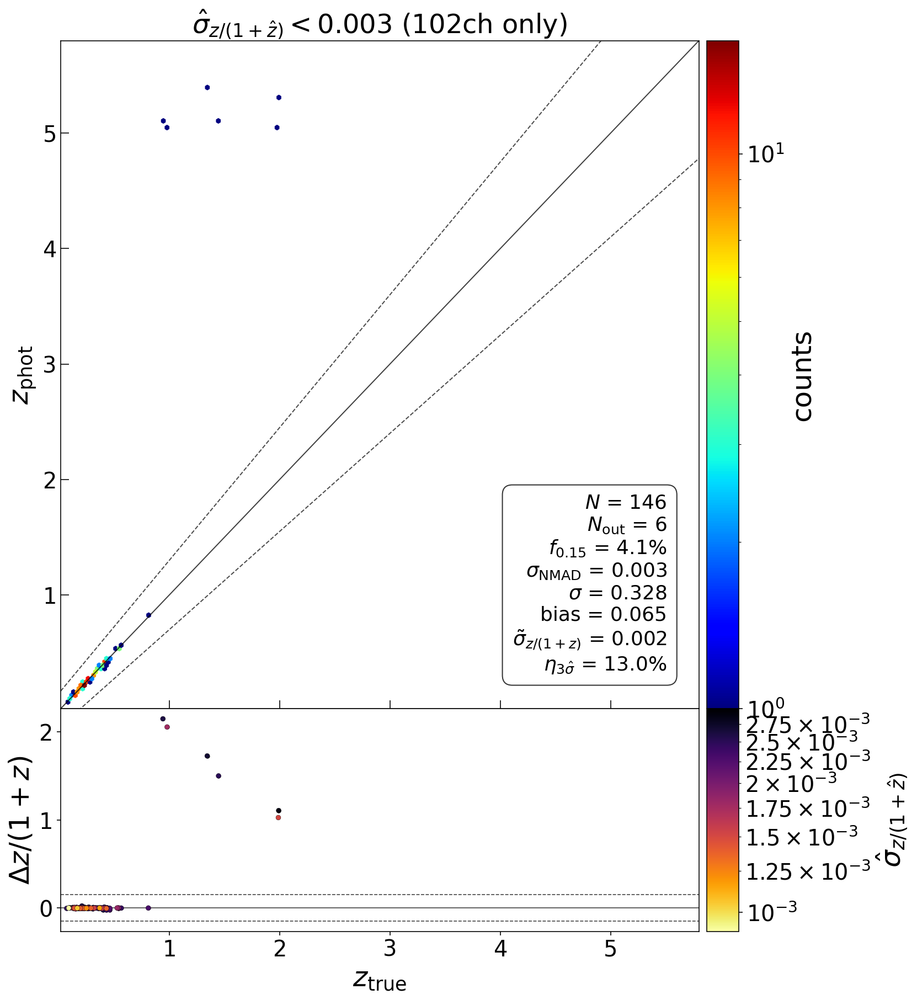

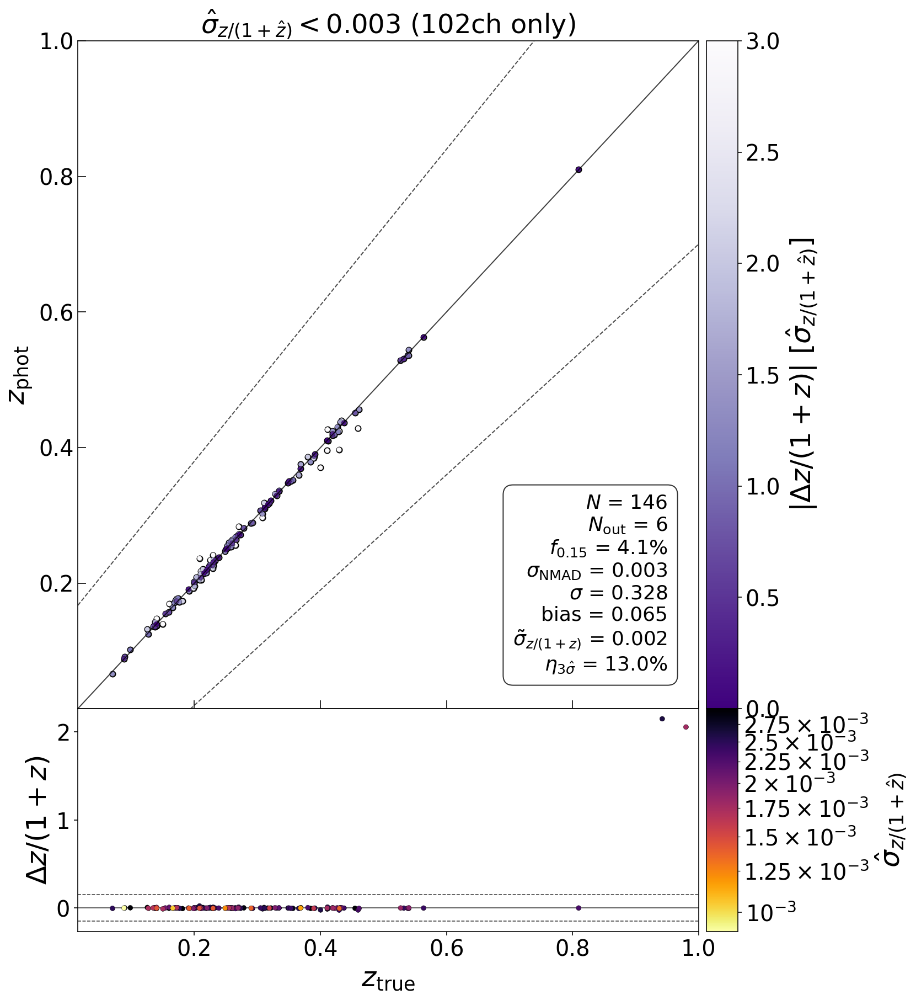

In [40]:
sigzmask = (s < 0.003)

id_out = plot_comp_hexbin(x[sigzmask], y[sigzmask],
                          np.ones_like(x[sigzmask]),
                          FIGDIR/'sigz_hexbin_lt0003.png', np.arange(len(x[sigzmask])),
                          z_840=base['z840'][idxs][sigzmask], z_160=base['z160'][idxs][sigzmask],
                          label_x=r"$z_{\rm true}$", label_y=r"$z_{\rm phot}$",
                          title=r'$\hat{\sigma}_{z/(1+\hat{z})} < 0.003$'+SCHEME,
                          xmin=0.015, xmax=5.8, cmap='jet',
                          scatter_plot=False, gridsize=(87*2,50*2), log_scale=False,
                          residual_plot=True, residual_ylim=None)
id_out = plot_comp_hexbin(x[sigzmask], y[sigzmask],
                          np.ones_like(x[sigzmask]),
                          FIGDIR/'sigz_scatter_lt0003.png', np.arange(len(x[sigzmask])),
                          z_840=base['z840'][idxs][sigzmask], z_160=base['z160'][idxs][sigzmask],
                          label_x=r"$z_{\rm true}$", label_y=r"$z_{\rm phot}$",
                          title=r'$\hat{\sigma}_{z/(1+\hat{z})} < 0.003$'+SCHEME,
                          xmin=0.015, xmax=1, cmap='jet',
                          scatter_plot=True, gridsize=(87*2,50*2), log_scale=False,
                          residual_plot=True, residual_ylim=None, no_hexbin=True)

Objects : 350
Outliers: 0


Objects : 350
Outliers: 0




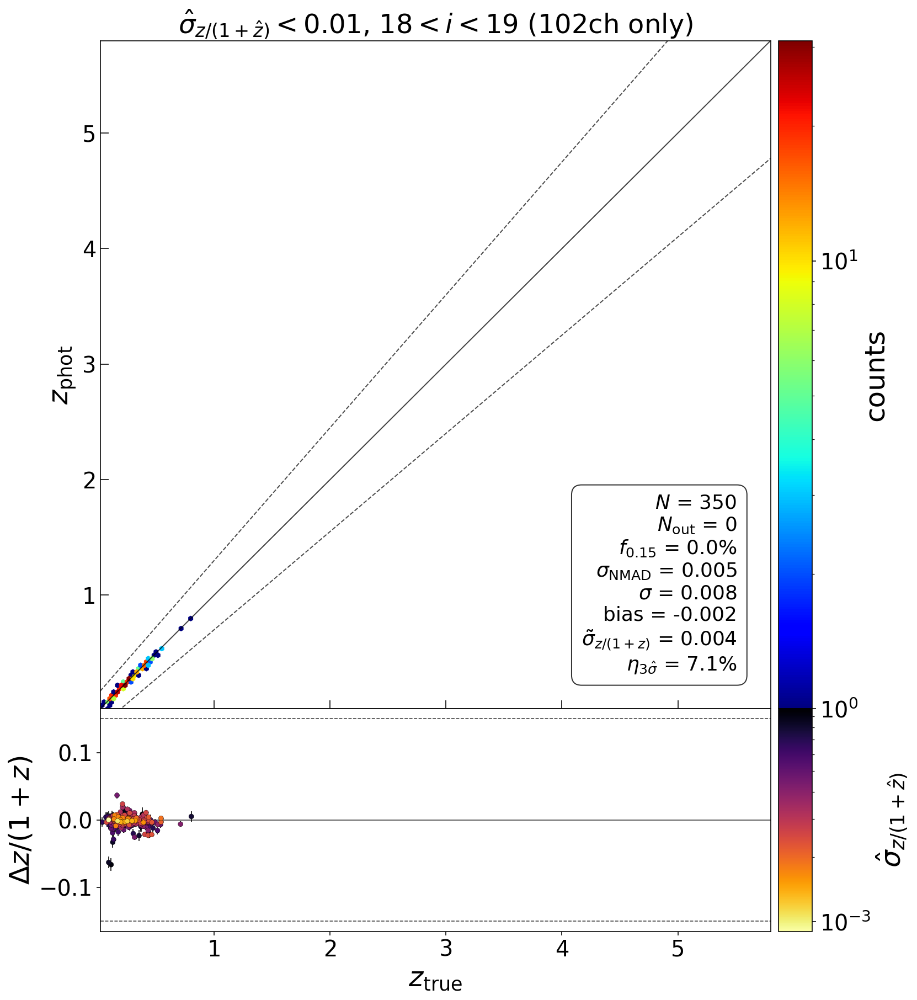

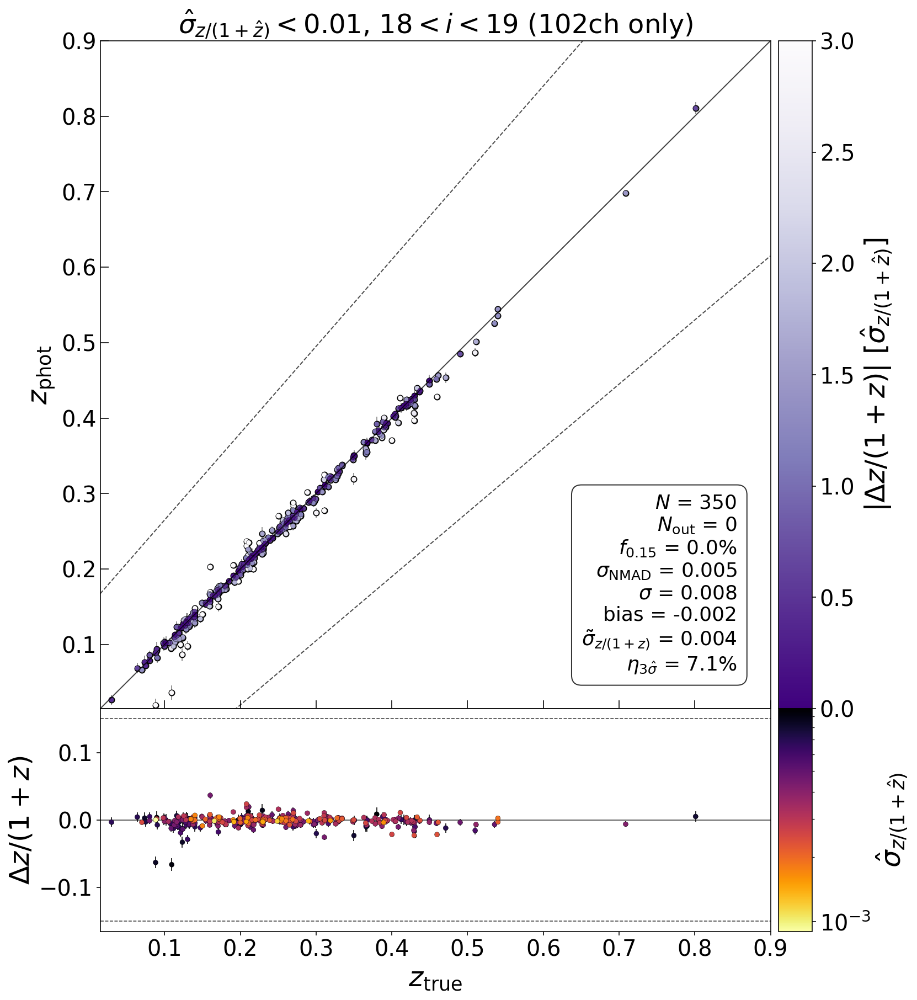

In [41]:
sigzmask = (s < 0.01)
iband = base['HSC_i_MAG'][idxs]
imin = 18
imax = 19
imask = (iband > imin) & (iband < imax)
mask = sigzmask & imask


id_out = plot_comp_hexbin(x[mask], y[mask],
                          np.ones_like(x[mask]),
                          FIGDIR/f'i_gt{imin}lt{imax}_sigz_lt001_hexbin.png', np.arange(len(x[mask])),
                          z_840=base['z840'][idxs][mask], z_160=base['z160'][idxs][mask],
                          label_x=r"$z_{\rm true}$", label_y=r"$z_{\rm phot}$",
                          title=r'$\hat{\sigma}_{z/(1+\hat{z})} < 0.01$, '+f'${imin}<i<{imax}$'+SCHEME,
                          xmin=0.015, xmax=5.8, cmap='jet',
                          scatter_plot=False, gridsize=(87*2,50*2), log_scale=False,
                          residual_plot=True, residual_ylim=None)
id_out = plot_comp_hexbin(x[mask], y[mask],
                          np.ones_like(x[mask]),
                          FIGDIR/f'i_gt{imin}lt{imax}_sigz_lt001_scatter.png', np.arange(len(x[mask])),
                          z_840=base['z840'][idxs][mask], z_160=base['z160'][idxs][mask],
                          label_x=r"$z_{\rm true}$", label_y=r"$z_{\rm phot}$",
                          title=r'$\hat{\sigma}_{z/(1+\hat{z})} < 0.01$, '+f'${imin}<i<{imax}$'+SCHEME,
                          xmin=0.015, xmax=0.9, cmap='jet',
                          scatter_plot=True, gridsize=(87*2,50*2), log_scale=False,
                          residual_plot=True, residual_ylim=None, no_hexbin=True)

Objects : 714
Outliers: 0


Objects : 714
Outliers: 0




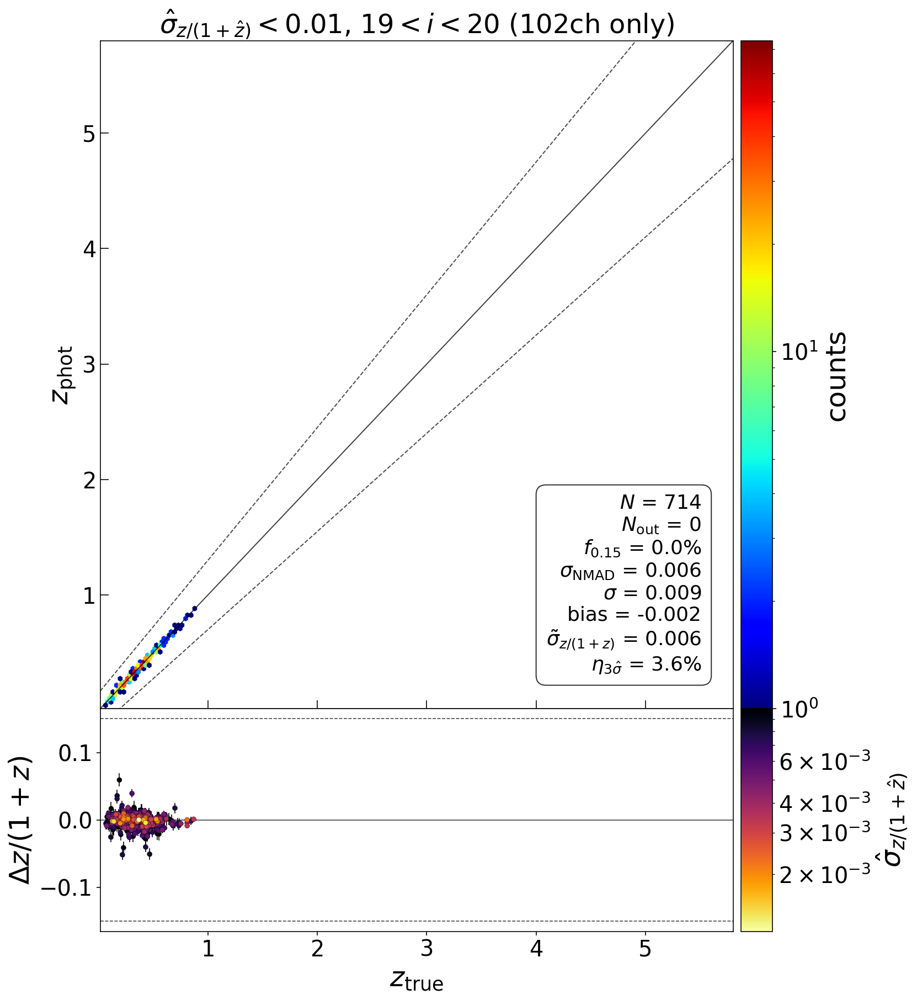

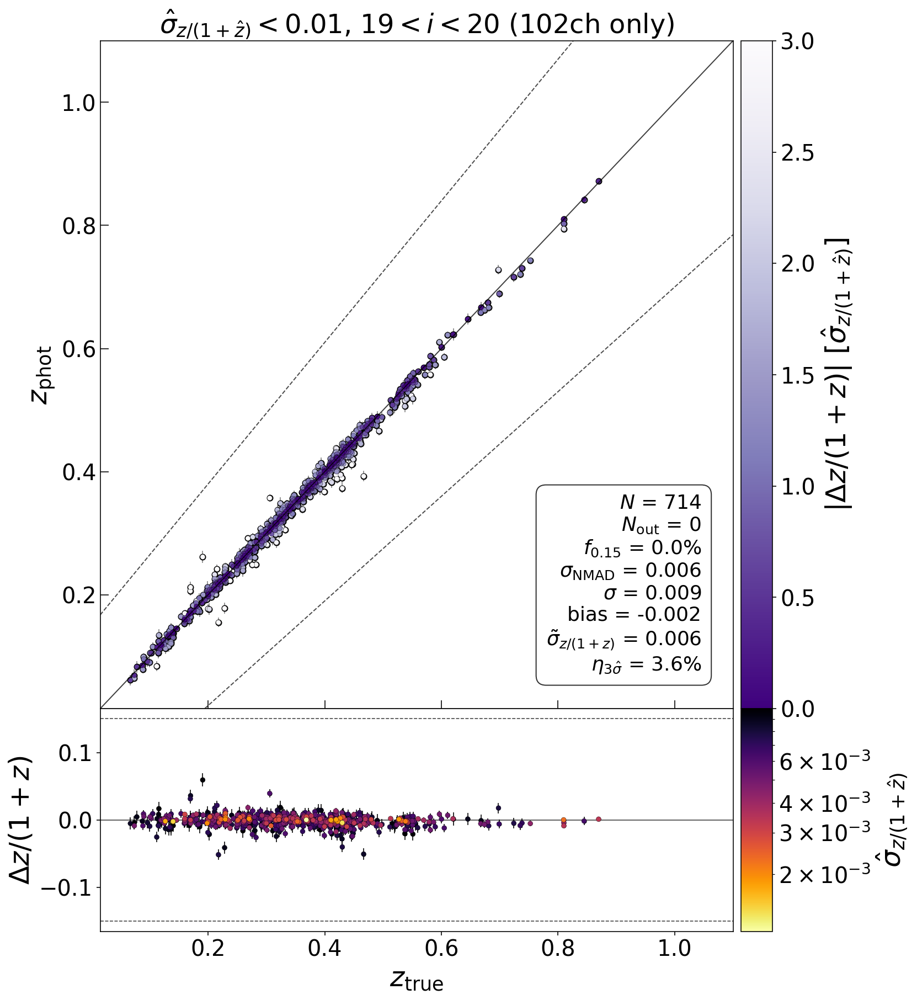

In [42]:
sigzmask = (s < 0.01)
iband = base['HSC_i_MAG'][idxs]
imin = 19
imax = 20
imask = (iband > imin) & (iband < imax)
mask = sigzmask & imask


id_out = plot_comp_hexbin(x[mask], y[mask],
                          np.ones_like(x[mask]),
                          FIGDIR/f'i_gt{imin}lt{imax}_sigz_lt001_hexbin.png', np.arange(len(x[mask])),
                          z_840=base['z840'][idxs][mask], z_160=base['z160'][idxs][mask],
                          label_x=r"$z_{\rm true}$", label_y=r"$z_{\rm phot}$",
                          title=r'$\hat{\sigma}_{z/(1+\hat{z})} < 0.01$, '+f'${imin}<i<{imax}$'+SCHEME,
                          xmin=0.015, xmax=5.8, cmap='jet',
                          scatter_plot=False, gridsize=(87*2,50*2), log_scale=False,
                          residual_plot=True, residual_ylim=None)
id_out = plot_comp_hexbin(x[mask], y[mask],
                          np.ones_like(x[mask]),
                          FIGDIR/f'i_gt{imin}lt{imax}_sigz_lt001_scatter.png', np.arange(len(x[mask])),
                          z_840=base['z840'][idxs][mask], z_160=base['z160'][idxs][mask],
                          label_x=r"$z_{\rm true}$", label_y=r"$z_{\rm phot}$",
                          title=r'$\hat{\sigma}_{z/(1+\hat{z})} < 0.01$, '+f'${imin}<i<{imax}$'+SCHEME,
                          xmin=0.015, xmax=1.1, cmap='jet',
                          scatter_plot=True, gridsize=(87*2,50*2), log_scale=False,
                          residual_plot=True, residual_ylim=None, no_hexbin=True)

Objects : 534
Outliers: 0


Objects : 534
Outliers: 0




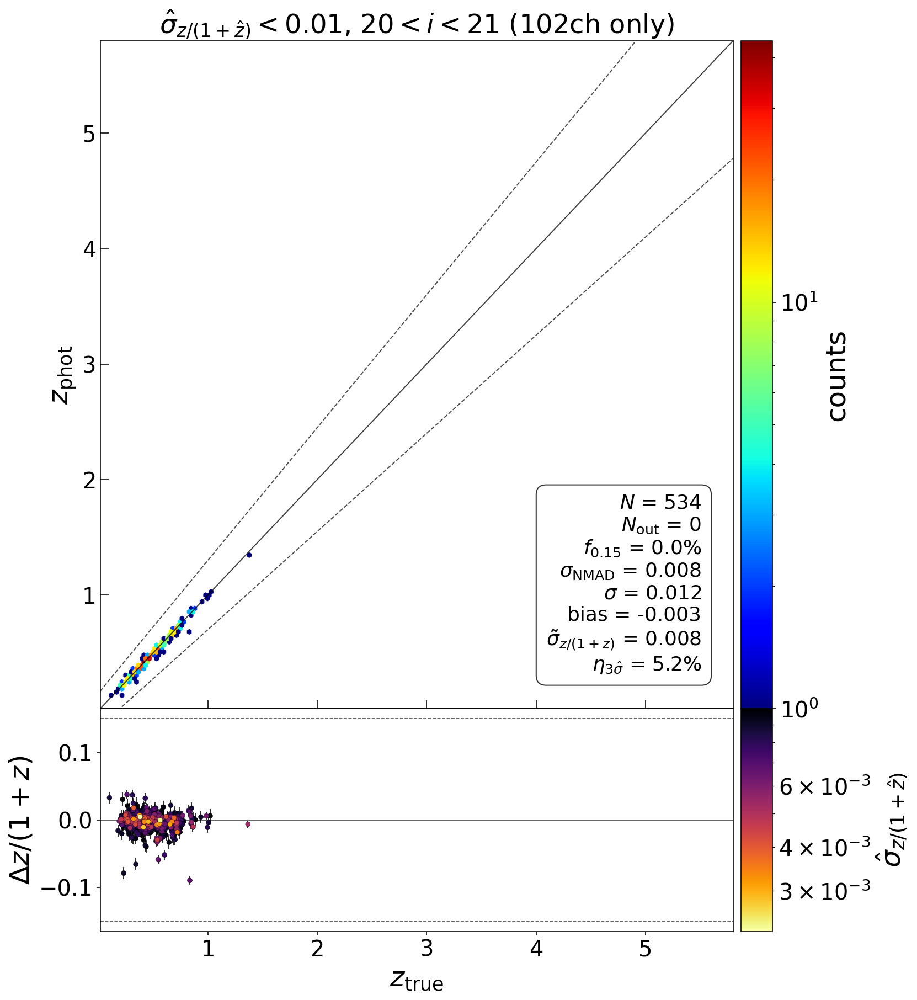

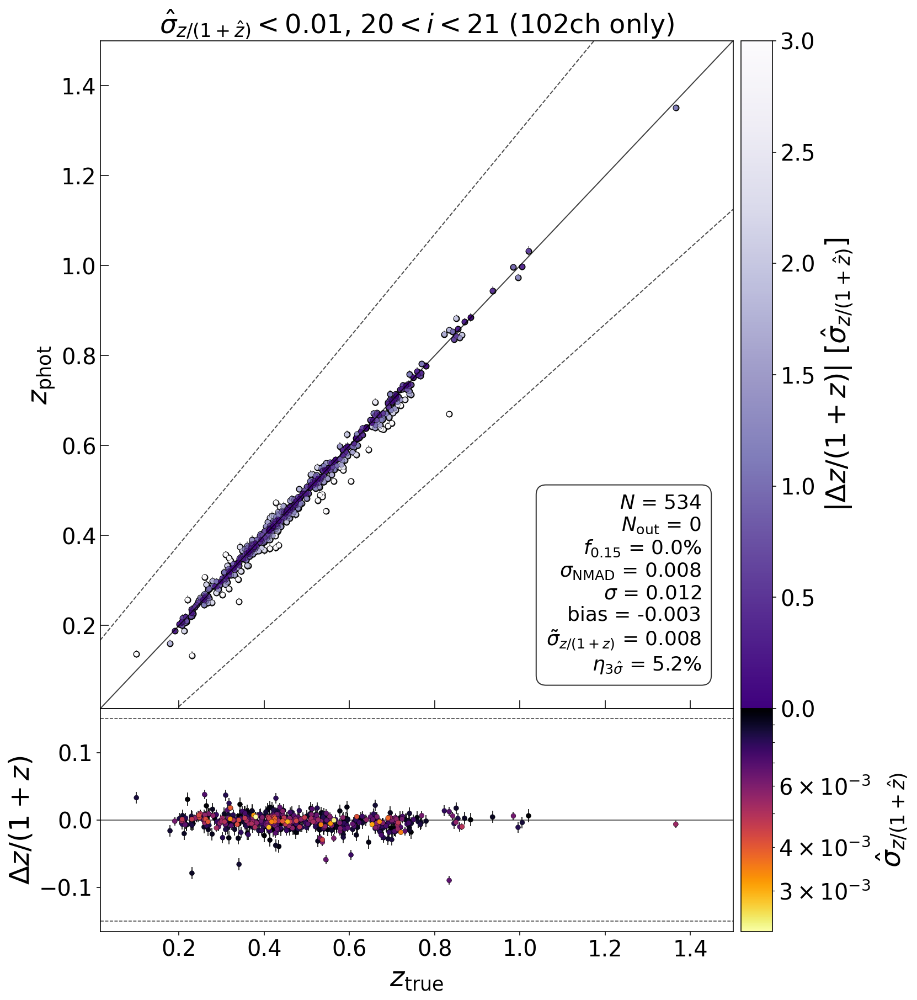

In [43]:
sigzmask = (s < 0.01)
iband = base['HSC_i_MAG'][idxs]
imin = 20
imax = 21
imask = (iband > imin) & (iband < imax)
mask = sigzmask & imask


id_out = plot_comp_hexbin(x[mask], y[mask],
                          np.ones_like(x[mask]),
                          FIGDIR/f'i_gt{imin}lt{imax}_sigz_lt001_hexbin.png', np.arange(len(x[mask])),
                          z_840=base['z840'][idxs][mask], z_160=base['z160'][idxs][mask],
                          label_x=r"$z_{\rm true}$", label_y=r"$z_{\rm phot}$",
                          title=r'$\hat{\sigma}_{z/(1+\hat{z})} < 0.01$, '+f'${imin}<i<{imax}$'+SCHEME,
                          xmin=0.015, xmax=5.8, cmap='jet',
                          scatter_plot=False, gridsize=(87*2,50*2), log_scale=False,
                          residual_plot=True, residual_ylim=None)
id_out = plot_comp_hexbin(x[mask], y[mask],
                          np.ones_like(x[mask]),
                          FIGDIR/f'i_gt{imin}lt{imax}_sigz_lt001_scatter.png', np.arange(len(x[mask])),
                          z_840=base['z840'][idxs][mask], z_160=base['z160'][idxs][mask],
                          label_x=r"$z_{\rm true}$", label_y=r"$z_{\rm phot}$",
                          title=r'$\hat{\sigma}_{z/(1+\hat{z})} < 0.01$, '+f'${imin}<i<{imax}$'+SCHEME,
                          xmin=0.015, xmax=1.5, cmap='jet',
                          scatter_plot=True, gridsize=(87*2,50*2), log_scale=False,
                          residual_plot=True, residual_ylim=None, no_hexbin=True)

Objects : 180
Outliers: 5




Objects : 180
Outliers: 5




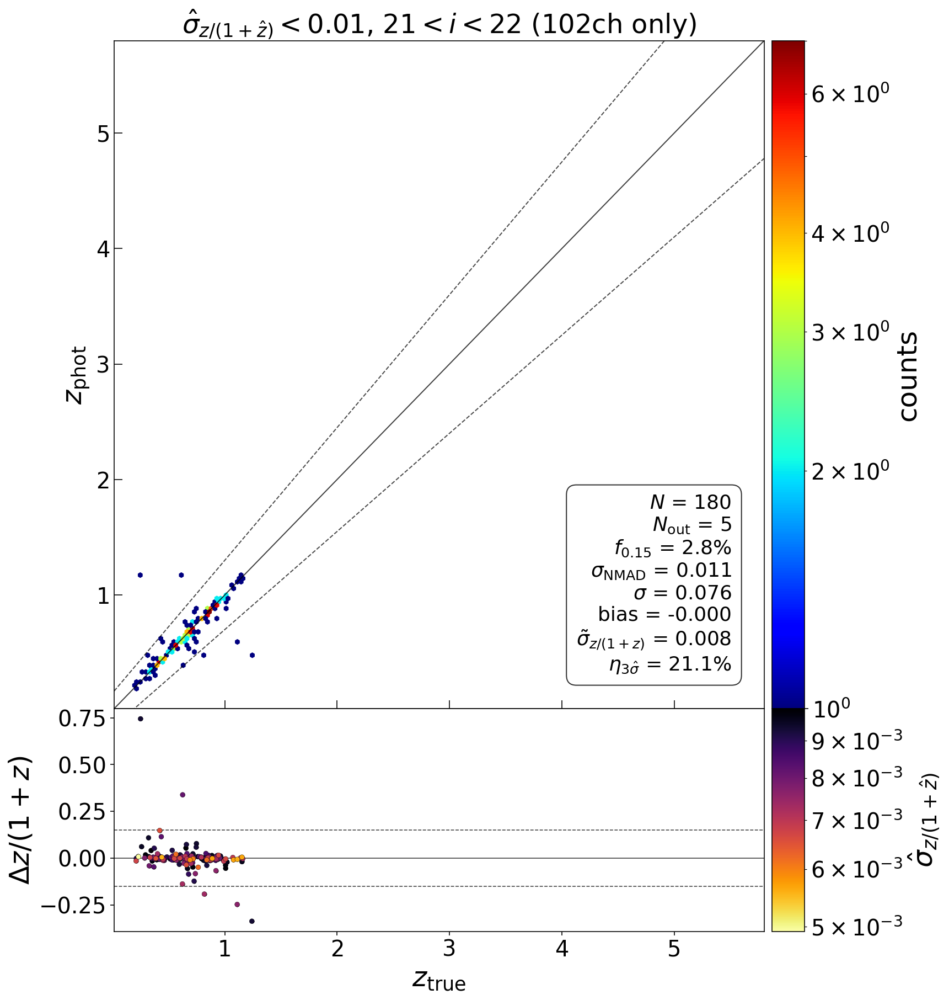

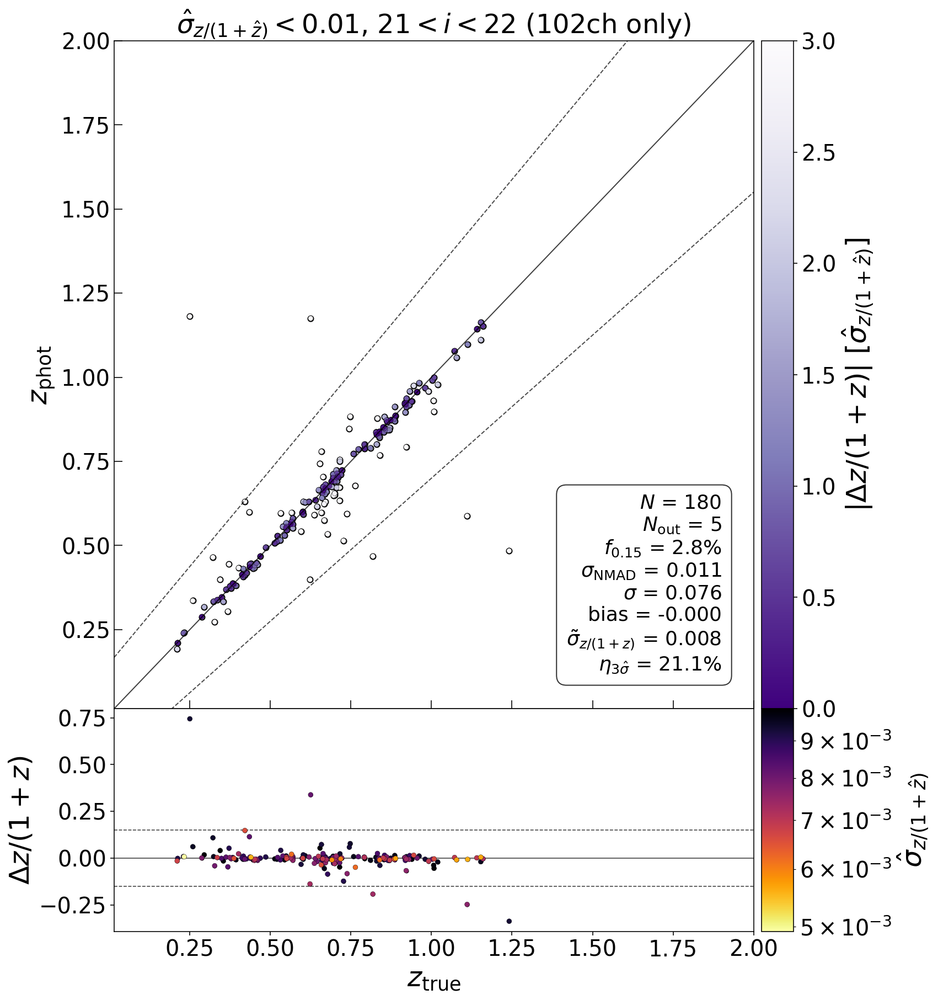

In [44]:
sigzmask = (s < 0.01)
iband = base['HSC_i_MAG'][idxs]
imin = 21
imax = 22
imask = (iband > imin) & (iband < imax)
mask = sigzmask & imask


id_out = plot_comp_hexbin(x[mask], y[mask],
                          np.ones_like(x[mask]),
                          FIGDIR/f'i_gt{imin}lt{imax}_sigz_lt001_hexbin.png', np.arange(len(x[mask])),
                          z_840=base['z840'][idxs][mask], z_160=base['z160'][idxs][mask],
                          label_x=r"$z_{\rm true}$", label_y=r"$z_{\rm phot}$",
                          title=r'$\hat{\sigma}_{z/(1+\hat{z})} < 0.01$, '+f'${imin}<i<{imax}$'+SCHEME,
                          xmin=0.015, xmax=5.8, cmap='jet',
                          scatter_plot=False, gridsize=(87*2,50*2), log_scale=False,
                          residual_plot=True, residual_ylim=None)
id_out = plot_comp_hexbin(x[mask], y[mask],
                          np.ones_like(x[mask]),
                          FIGDIR/f'i_gt{imin}lt{imax}_sigz_lt001_scatter.png', np.arange(len(x[mask])),
                          z_840=base['z840'][idxs][mask], z_160=base['z160'][idxs][mask],
                          label_x=r"$z_{\rm true}$", label_y=r"$z_{\rm phot}$",
                          title=r'$\hat{\sigma}_{z/(1+\hat{z})} < 0.01$, '+f'${imin}<i<{imax}$'+SCHEME,
                          xmin=0.015, xmax=2, cmap='jet',
                          scatter_plot=True, gridsize=(87*2,50*2), log_scale=False,
                          residual_plot=True, residual_ylim=None, no_hexbin=True)

Objects : 102
Outliers: 31




Objects : 102
Outliers: 31




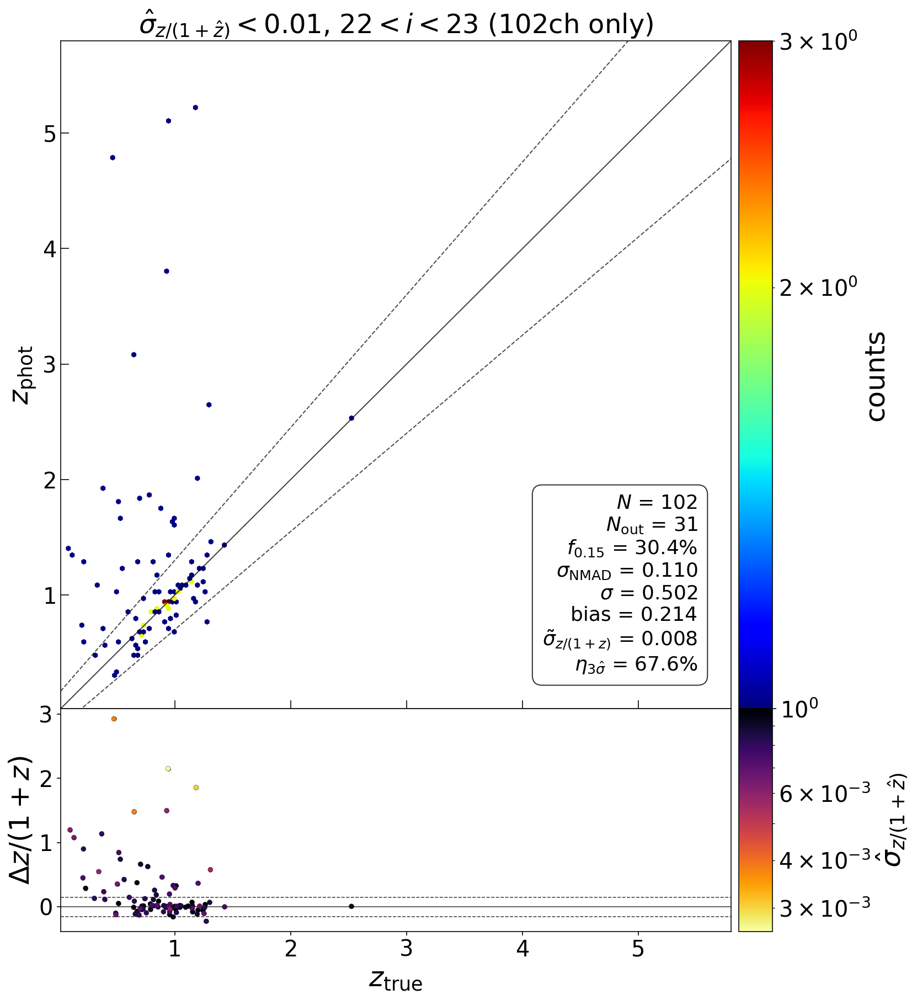

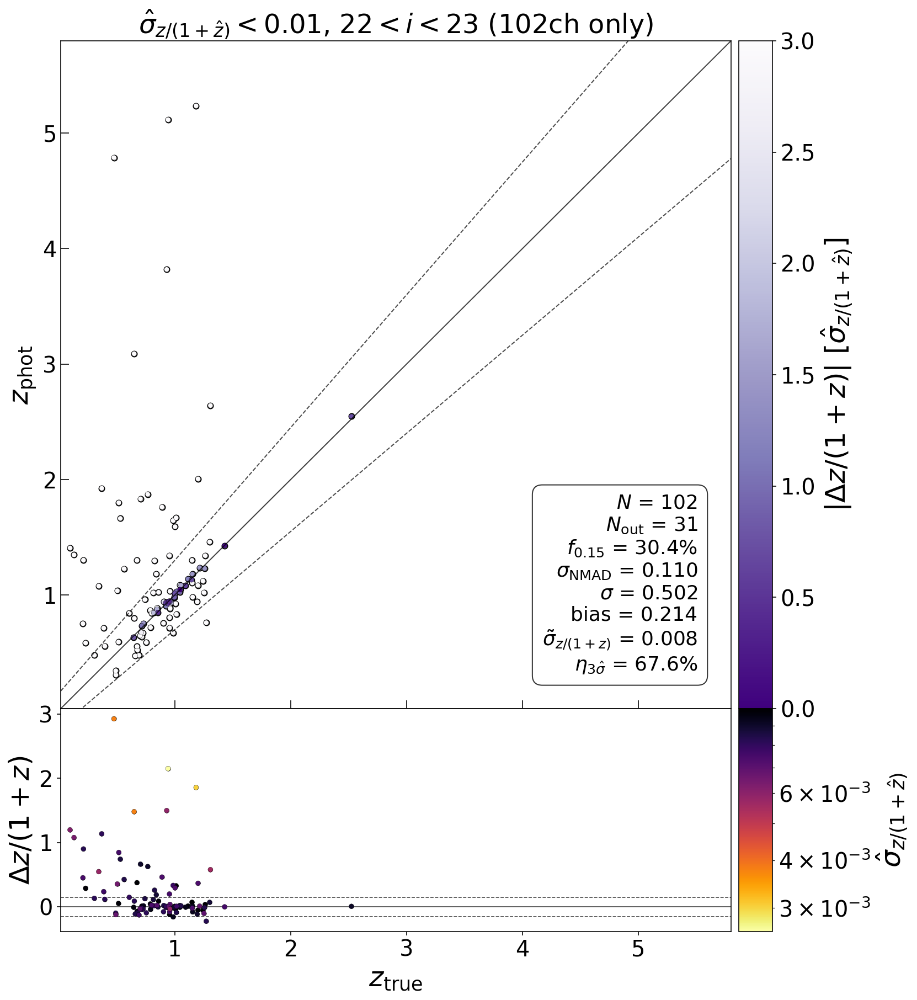

In [45]:
sigzmask = (s < 0.01)
iband = base['HSC_i_MAG'][idxs]
imin = 22
imax = 23
imask = (iband > imin) & (iband < imax)
mask = sigzmask & imask


id_out = plot_comp_hexbin(x[mask], y[mask],
                          np.ones_like(x[mask]),
                          FIGDIR/f'i_gt{imin}lt{imax}_sigz_lt001_hexbin.png', np.arange(len(x[mask])),
                          z_840=base['z840'][idxs][mask], z_160=base['z160'][idxs][mask],
                          label_x=r"$z_{\rm true}$", label_y=r"$z_{\rm phot}$",
                          title=r'$\hat{\sigma}_{z/(1+\hat{z})} < 0.01$, '+f'${imin}<i<{imax}$'+SCHEME,
                          xmin=0.015, xmax=5.8, cmap='jet',
                          scatter_plot=False, gridsize=(87*2,50*2), log_scale=False,
                          residual_plot=True, residual_ylim=None)
id_out = plot_comp_hexbin(x[mask], y[mask],
                          np.ones_like(x[mask]),
                          FIGDIR/f'i_gt{imin}lt{imax}_sigz_lt001_scatter.png', np.arange(len(x[mask])),
                          z_840=base['z840'][idxs][mask], z_160=base['z160'][idxs][mask],
                          label_x=r"$z_{\rm true}$", label_y=r"$z_{\rm phot}$",
                          title=r'$\hat{\sigma}_{z/(1+\hat{z})} < 0.01$, '+f'${imin}<i<{imax}$'+SCHEME,
                          xmin=0.015, xmax=5.8, cmap='jet',
                          scatter_plot=True, gridsize=(87*2,50*2), log_scale=False,
                          residual_plot=True, residual_ylim=None, no_hexbin=True)